## Longevity Bayes Net


First we create a Pomegranate Bayesian Network using the protobuf interface and our utility package, bayesnet, that enables one to conveniently create a Bayesian network by hand, and in accord with common statistics and rules, without having to fill in every probability.  The same Baysian network can start with our hand entered rules, but can later learn from data.  Any amount of questions can be answered, including no questions, to get the probabilities .  The file the Bayesian net is written in is longevity_bayes.py.  Our utility package can then be used to query the network with different evidence of states.  This is convenient for tuning hand entered parameters .



In [1]:
import sys
!{sys.executable} -m pip install --upgrade pip
!{sys.executable} -m pip install -e ../bayesnet
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install networkx
!{sys.executable} -m pip install graphviz
!{sys.executable} -m pip install datetime
!{sys.executable} -m pip install grpcio
!{sys.executable} -m pip install --no-cache-dir --upgrade numpy
!{sys.executable} -m pip install pomegranate==0.14.0
!{sys.executable} -m pip install qpsolvers
!{sys.executable} -m pip install osqp





Obtaining file:///home/opencog/bayesnet
  Preparing metadata (setup.py) ... done
  Attempting uninstall: covid-bayes
    Found existing installation: covid-bayes 1.0
    Can't uninstall 'covid-bayes'. No files were found to uninstall.
  Running setup.py develop for covid-bayes


In [2]:
!{sys.executable} -m pip install -r requirements.txt
!sh buildproto.sh

### Longevity net
Here put the name of the network you have written with the protobuf and bayes utilities.  Our example is printed out.  We created 4 functions in our utility package: any_of, all_of, if_the_else, and avg, which can together be used to express almost any set of rules, documented elsewhere.  We also implemented a dependency rule with which one can enter statistics from Systematic Reviews and Meta analyses easily.  The last lines implement the creation of the description of the network,  bayesianNetwork , with the protobuf utilities, and then the creation of the Pomegranate network with the description.  

In [3]:
text_file = open('./sn_bayes/longevity_bayes.py')
#text_file = open('./sn_bayes/longevity_bayes_short.py')
file_content = text_file.read()
print(file_content)
text_file.close()

import sn_bayes
from sn_bayes.utils import any_of
from sn_bayes.utils import all_of
from sn_bayes.utils import avg
from sn_bayes.utils import if_then_else
from sn_bayes.utils import bayesInitialize
from sn_bayes.utils import addCpt
from sn_bayes.utils import dependency
from sn_bayes.utils import non_cpt_descriptions

import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetwork


def longevity_bayes():
        bayesianNetwork = BayesianNetwork()
        cpt = {}
        outstr = '' 
                
        #probabilities within distributions must sum to 1.0
    #questions left blank or "prefer not to answer" will be computed

    #anomalies
        
                # increasing variability in step is associated with 
                # loss of resiliance , the root of aging
                # https://www.nature.com/articles/s41467-021-23014-1
                
                #variablility of number of steps within a day

        anomaly = b

 Next run the file and print the rules in it in human readable format.  All routines are stateless.

## Timing:  compiling, computation, explaning
Below you see that it takes about 1 hour and 16 minutes to compile the file.  However, the user does not experience this delay, just the programmer.  Later this notebook you will see that the computation time, to get to the answer when it is running, is about 7 seconds.  Times to get an explanation depend on how many possible explanations we want to cover: for example, if there are 60 things to check, it takes 16 seconds.  We have made a way to retrieve the answers gradually over that time, if necessary.

In [4]:
import qpsolvers
print(qpsolvers.available_solvers)


['osqp', 'quadprog']


In [5]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


start timing...
start timing...
[({'age': ['elderly']}, {'relative_risk': 2.3})] ==> {'angina_yes': 0.03, 'angina_no': 0.97} took 0.026884657330811024 seconds
{'angina_yes': 0.03, 'angina_no': 0.97}  wrapper took 0.05243188329041004 seconds
start timing...
start timing...
[({'angina': ['angina_yes']}, {'relative_risk': 5})] ==> {'daily_asprin_prescription_yes': 0.05, 'daily_asprin_prescription_no': 0.95} took 0.016781538724899292 seconds
{'daily_asprin_prescription_yes': 0.05, 'daily_asprin_prescription_no': 0.95}  wrapper took 0.016863218508660793 seconds
start timing...
start timing...
[({'angina': ['angina_yes']}, {'relative_risk': 2})] ==> {'blood_relative_heart_attack_before_50_yes': 0.13, 'blood_relative_heart_attack_before_50_no': 0.87} took 0.016692322678864002 seconds
{'blood_relative_heart_attack_before_50_yes': 0.13, 'blood_relative_heart_attack_before_50_no': 0.87}  wrapper took 0.016787778586149216 seconds
start timing...
start timing...
[({'angina': ['angina_yes']}, {'rel

/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted P to scipy.sparse.csc.csc_matrix
For best performance, build P as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"
/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/typing.py:49: UserWarning: Converted A to scipy.sparse.csc.csc_matrix
For best performance, build A as a scipy.sparse.csc_matrix rather than as a numpy.ndarray
  f"Converted {matrix_name} to scipy.sparse.csc.csc_matrix\n"
/usr/local/lib/python3.6/dist-packages/qpsolvers/solvers/osqp_.py:156: UserWarning: OSQP exited with status 'primal infeasible'
  warn("OSQP exited with status '%s'" % res.info.status)


[({'bmi': ['bmi_over_40_high_risk', 'bmi_35_to_39_moderate_risk']}, {'sensitivity': 0.75, 'specificity': 0.85})] ==> {'hip_above_112.70': 0.25, 'no_hip_above_112.70': 0.75} took 0.02335080225020647 seconds
{'hip_above_112.70': 0.25, 'no_hip_above_112.70': 0.75}  wrapper took 0.023439968936145306 seconds
start timing...
start timing...
[({'hip': ['hip_above_112.70']}, {'sensitivity': 0.75, 'specificity': 0.85})] ==> {'waist_above_109.00': 0.25, 'no_waist_above_109.00': 0.75} took 0.03367872629314661 seconds
{'waist_above_109.00': 0.25, 'no_waist_above_109.00': 0.75}  wrapper took 0.03375877346843481 seconds
start timing...
start timing...
[({'ten_minutes_daily_workout': ['ten_minutes_daily_workout_no']}, {'relative_risk': 2.341285178, 'plus_minus': 0.866177854, 'ci': 95})] ==> {'workday_sleep_under_5': 0.06, 'workday_sleep_under_5_no': 0.94} took 0.04420597665011883 seconds
{'workday_sleep_under_5': 0.06, 'workday_sleep_under_5_no': 0.94}  wrapper took 0.04915918782353401 seconds
start 

[({'micro_nucleus_frequency': ['micro_nucleus_frequency_above_6']}, {'relative_risk': 1.25, 'plus_minus': 0.15, 'ci': 95}), ({'workday_sleep_hours_per_night': ['workday_sleep_under_5']}, {'relative_risk': 1.4, 'plus_minus': 0.16, 'ci': 95})] ==> {'cognitive_impairment': 0.08, 'no_cognitive_impairment': 0.92} took 0.8715214105322957 seconds
{'cognitive_impairment': 0.08, 'no_cognitive_impairment': 0.92}  wrapper took 0.8756694803014398 seconds
start timing...
start timing...
[({'ten_minutes_daily_workout': ['ten_minutes_daily_workout_yes']}, {'relative_risk': 0.71, 'plus_minus': 0.47, 'ci': 95}), ({'coq10_supplementation': ['coq10_supplementation_yes']}, {'relative_risk': 0.05425283662, 'plus_minus': 0.1613152025, 'ci': 95})] ==> {'interleukin_6_above_5': 0.08, 'interleukin_6_ab0ve_5_no': 0.92} took 0.8624608032405376 seconds
{'interleukin_6_above_5': 0.08, 'interleukin_6_ab0ve_5_no': 0.92}  wrapper took 0.8664786824956536 seconds
start timing...
start timing...
[({'ten_minutes_daily_wo

[({'daily_time_sitting': ['daily_time_sitting_12_or_more_hours']}, {'relative_risk': 3, 'plus_minus': 0.15, 'ci': 95}), ({'workday_sleep_hours_per_night': ['workday_sleep_under_5']}, {'relative_risk': 1.17, 'plus_minus': 0.08, 'ci': 95}), ({'dietary_sodium': ['dietary_sodium_above_4297.00']}, {'relative_risk': 2.17}), ({'inflammation': ['inflammation']}, {'relative_risk': 2})] ==> {'hypertension_from_behavior': 0.17, 'no_hypertension_from_behavior': 0.83} took 195.14674387313426 seconds
{'hypertension_from_behavior': 0.17, 'no_hypertension_from_behavior': 0.83}  wrapper took 195.1503002261743 seconds
start timing...
start timing...
[({'hypertension_from_behavior': ['hypertension_from_behavior']}, {'sensitivity': 0.8, 'specificity': 0.95}), ({'c_reactive_protein': ['c_reactive_protein_high_above_2']}, {'relative_risk': 1.2}), ({'dna_methylation': ['dna_methylation_above_.3_no']}, {'relative_risk': 0.07, 'plus_minus': 0.01, 'ci': 95}), ({'reported_hypertension': ['reported_hypertension']

[({'diabetes_from_behavior': ['diabetes_from_behavior']}, {'sensitivity': 0.8, 'specificity': 0.95}), ({'a1c': ['a1c_diabetes_5.7_and_above']}, {'sensitivity': 0.95, 'specificity': 0.95}), ({'age': ['elderly']}, {'relative_risk': 4.5}), ({'hypertension': ['hypertension']}, {'relative_risk': 3.8})] ==> {'diabetes': 0.12, 'no_diabetes': 0.88} took 225.70033294614404 seconds
{'diabetes': 0.12, 'no_diabetes': 0.88}  wrapper took 225.70087136235088 seconds
start timing...
start timing...
[({'age': ['elderly']}, {'relative_risk': 7}), ({'obesity': ['obesity']}, {'relative_risk': 2}), ({'daily_time_sitting': ['daily_time_sitting_12_or_more_hours']}, {'relative_risk': 1.179, 'plus_minus': 0.073, 'ci': 95}), ({'workday_sleep_hours_per_night': ['workday_sleep_under_5']}, {'relative_risk': 1.26, 'plus_minus': 0.11, 'ci': 95}), ({'daily_fruit_vegetable_servings': ['daily_fruit_vegetable_servings_over_4_yes']}, {'relative_risk': 0.96, 'plus_minus': 0.04, 'ci': 95})] ==> {'cardiovascular_disease_fro

For convenience of creating a table, here are all the variables in the net in order.  They should be mapped into the individual buckets of the rules.  

In [6]:
import sn_bayes
from sn_bayes.utils import complexity_check
complexity_check(bayesianNetwork)

(True, '')

In [7]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'fake_variable': 0,
 'age': 1,
 'daily_aspirin_compliance': 2,
 'high_blood_pressure_patient_prescription': 3,
 'high_blood_pressure_medication_compliance': 4,
 'diastolic': 5,
 'systolic': 6,
 'sun_exposure_half_hour': 7,
 'time_spent_outdoors': 8,
 'sun_exposure_use_sunscreen': 9,
 'sunburn_last_year': 10,
 'weight_at_25': 11,
 'bmi': 12,
 'dietary_energy': 13,
 'shortness_of_breath_exertion': 14,
 'daily_walk_or_bicycle_travel': 15,
 'daily_time_sitting': 16,
 'physical_work': 17,
 'ten_minutes_daily_workout': 18,
 'heart_rate_anomaly': 19,
 'steps_anomaly': 20,
 'workout_anomaly': 21,
 'walking_speed_anomaly': 22,
 'walking_speed_variability_anomaly': 23,
 'stride_variability_anomaly': 24,
 'step_asymmetry_anomaly': 25,
 'double_support_stepping_anomaly': 26,
 'step_variability_anomaly': 27,
 'cumin_supplementation': 28,
 'anxious_how_often': 29,
 'marital_status': 30,
 'birth_weight': 31,
 'asthma_attack_last_year': 32,
 'liver_condition': 33,
 'fatiqued_in_2_weeks': 34,
 'osteop

Here are the positions of every bucketed response for each of the above variables:

In [8]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'fake_variable': {'fake_variable_1': 0,
  'fake_variable_2': 1,
  'fake_variable_3': 2,
  'fake_variable_4': 3,
  'fake_variable_5': 4},
 'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun

We create a spreadsheet of the above for reference

In [9]:
import pandas as pd

rows_list = []
outname = "varvals.csv"
for var, valdict in var_val_positions.items():
    rowdict = {} 
    rows_list.append(rowdict)
    varstr= var +"("
    for val, pos in valdict.items():
        varstr += val
        varstr+= ","
            
    varstr=varstr[:-1]+")"
    rowdict["variable"] = varstr        

df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

## Variables to connect to , in order to fill in the health recommendations

diet:  "poor_diet".  upshot will not include socioeconomic status in recommendations and will recommend to increase or decrease things in diet, including calories


supplements:  "poor_diet_flag".  This shows area of deficiency that may need supplementation over and above diet


sleep hygiene:  "poor_sleep"


body weight: "obesity"


exercise: "lack_of_exercise"


lifestyle:   - "poor_diet_quantity"(water caffine sodium alcohol) + "psychological_disorders"(anxiety and marital status) + "smoking".  Just add to each other, do not rank with the same numbers to each.

## Variables to conect to, in order to fill in the hallmarks

"hallmark_1_genomic_instability"

"hallmark_2_telomere_attrition"

"hallmark_3_epigenetic_alterations"

"hallmark_4_loss_of_proteostasis"

"hallmark_5_deregulated_nutrient_sensing"

"hallmark_6_mitochondrial_dysfunction"

"hallmark_7_cellular_senescence"

"hallmark_8_stem_cell_exhaustion"

"hallmark_9_altered_intercellular_communication"

"hallmark_10_extracellular_matrix_dysfunction"
       

Here we create a spreadsheet that makes a Cartesian product of desired outputs with the remainder of the variables. This can be used to, for example, fill in a treatment recommendation for variables that are returned as causing the output in the explanation module 

In [10]:
import pandas as pd



#cols = ["leaves","internal","output"]
desired_output =["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]

rows_list = []
outname = "upshot.csv"

#put leaves in the first column, then internal vars along with the vars that feed them in the second.  
#and do a cartesian product with the outvars that are also internal vars (should be all of them)

for output in desired_output:
    for dist in bayesianNetwork.discreteDistributions:
        print(dist.name)
        rowdict = {} 
        rowdict["leaves"]= dist.name
        rowdict["internal"]=""
        rowdict["output"]= output
        rows_list.append(rowdict)
    for table in bayesianNetwork.conditionalProbabilityTables:
        print ("table: {}".format(table.name))
        rowdict = {}
        rowdict["leaves"]=""
        internal_str = table.name + " ("
        for var in table.randomVariables:
            print(var.name)
            internal_str += var.name
            internal_str+= ","         
        internal_str=internal_str[:-1]+")"
        rowdict["internal"] = internal_str
        rowdict["output"]= output
        rows_list.append(rowdict)

for dist in bayesianNetwork.discreteDistributions:
    print(dist.name)
    rowdict = {} 
    rowdict["leaves"]= dist.name
    rowdict["internal"]=""
    rowdict["output"]= ""
    rows_list.append(rowdict)
for table in bayesianNetwork.conditionalProbabilityTables:
    print ("table: {}".format(table.name))
    rowdict = {}
    rowdict["leaves"]=""
    internal_str = table.name + " ("
    for var in table.randomVariables:
        print(var.name)
        internal_str += var.name
        internal_str+= ","         
    internal_str=internal_str[:-1]+")"
    rowdict["internal"] = internal_str
    rowdict["output"]= ""
    rows_list.append(rowdict)
    
df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

fake_variable
age
daily_aspirin_compliance
high_blood_pressure_patient_prescription
high_blood_pressure_medication_compliance
diastolic
systolic
sun_exposure_half_hour
time_spent_outdoors
sun_exposure_use_sunscreen
sunburn_last_year
weight_at_25
bmi
dietary_energy
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
heart_rate_anomaly
steps_anomaly
workout_anomaly
walking_speed_anomaly
walking_speed_variability_anomaly
stride_variability_anomaly
step_asymmetry_anomaly
double_support_stepping_anomaly
step_variability_anomaly
cumin_supplementation
anxious_how_often
marital_status
birth_weight
asthma_attack_last_year
liver_condition
fatiqued_in_2_weeks
osteoporosis
artificial_joints
lymphocite_number
mchc
nucleated_red_blood_cells
blood_urea_nitrogen
chloride
globulin
bilirubin
total_protein
toxins_in_blood
segmented_neutrophils
cadmium
cobalt
chromium
mercury
manganese
lead
selenium
cotinine
eosinophils_percent
ferritin
hemo

poor_diet_supplements
poor_diet_basics
table: poor_diet_food
poor_diet_fats
poor_diet_vitamins_and_minerals
table: poor_diet_flag
poor_diet_quantity
poor_diet_food
table: diet_minerals_1
dietary_iron
dietary_magnesium
dietary_potassium
table: diet_minerals_2
dietary_zinc
dietary_copper
table: diet_minerals
diet_minerals_1
diet_minerals_2
table: diet_vitamin_a
dietary_retinol
dietary_alpha_carotene
dietary_beta_carotene
table: diet_vitamin_b_1
dietary_b6
dietary_folate
table: diet_vitamin_b_2
dietary_thiamin
dietary_riboflavin
dietary_b12
table: diet_vitamin_b
diet_vitamin_b_1
diet_vitamin_b_2
table: diet_vitamin_other
dietary_vitamin_C
dietary_alpha_tocopherol
dietary_calcium
table: diet_vitamins_and_minerals
diet_minerals
diet_vitamin_a
diet_vitamin_b
diet_vitamin_other
table: diet_fats
dietary_epa
dietary_pfa
dietary_fat
dietary_cholesterol
table: diet_basics
water_drank_yesterday
dietary_fiber
dietary_carbohydrate
dietary_energy
table: diet_supplements
dietary_lycopene
dietary_lutei

nucleated_red_blood_cells
globulin
white_blood_cell_count
table: blood_metabolism_disorder_indicators
total_cholesterol
triglycerides
a1c
direct_HDL
table: reported_heart_symptoms
daily_asprin_prescription
daily_aspirin_compliance
angina
chest_pain
blood_relative_heart_attack_before_age_50
table: blood_heart_disorder_indicators
creatine_phosphokinase
sodium
chloride
table: resting_heart_rate
heart_rate_anomaly
lack_of_exercise
table: signal_heart_disorder_indicators
resting_heart_rate
heart_rate_variability_anomaly
heart_rate_anomaly
table: heart_disorder_indicators
blood_heart_disorder_indicators
blood_metabolism_disorder_indicators
reported_heart_symptoms
signal_heart_disorder_indicators
table: blood_mild_liver_disorder_indicators
alkaline_phosphatase
aspartate_aminotransferase
alanine_aminotransferase
table: severe_blood_liver_disorder_indicators
bilirubin
total_protein
gamma_glutamyl_transferase
table: liver_disorders
severe_blood_liver_disorder_indicators
blood_mild_liver_disorder

education_level
have_health_insurance
prescription_health_insurance
how_many_times_saw_doctor_last_year
how_long_since_saw_doctor
what_is_your_annual_household_income
employment
age_at_first_child
last_dentist_visit
dental_bone_loss
oral_cancer_exam
immunocompromised
glucose_serum
daily_fruit_vegetable_servings
daily_wholegrain_servings
weekly_nut_servings
weekly_fish_servings
weekly_processed_meat_servings
daily_plant_protein_servings
dietary_d
table: angina
age
table: daily_asprin_prescription
angina
table: blood_relative_heart_attack_before_age_50
angina
table: chest_pain
angina
table: greatest_weight
weight_at_25
table: weight
greatest_weight
bmi
table: height
bmi
table: hip
bmi
table: waist
hip
table: lack_of_workout_reported
daily_walk_or_bicycle_travel
physical_work
ten_minutes_daily_workout
table: lack_of_exercise_reported
shortness_of_breath_exertion
daily_time_sitting
lack_of_workout_reported
table: lack_of_exercise_signal
workout_anomaly
walking_speed_anomaly
steps_anomaly
t

age
poor_diet
table: hallmark_2_telomere_attrition
smoking
gender
table: age_related_macular_degeneration
hallmark_2_telomere_attrition
table: diabetes_from_behavior
dietary_caffeine
daily_time_sitting
workday_sleep_hours_per_night
bmi
table: diabetes
diabetes_from_behavior
a1c
age
hypertension
table: hallmark_6_mitochondrial_dysfunction
inflammation
table: cardiovascular_disease_from_behavior
age
obesity
daily_time_sitting
workday_sleep_hours_per_night
daily_fruit_vegetable_servings
table: cardiovascular_disease
cardiovascular_disease_from_behavior
micro_nucleus_frequency
heart_disorder_indicators
diabetes
hypertension
table: metabolic_disease
cardiovascular_disease
diabetes
hypertension
table: lung_or_kidney_or_liver_disease
lung_disease
kidney_disease
liver_disorders
table: chronic_conditions
lung_or_kidney_or_liver_disease
immunocompromised
psychological_disorders
table: comorbidities
chronic_conditions
metabolic_disease
obesity
table: frailty_measures
inactivated_sirtuins
micro_nu

low_socioeconomic_status_healthcare
table: low_socioeconomic_status
low_socioeconomic_status_health
low_socioeconomic_status_demography
table: poor_diet_minerals_1
dietary_iron
dietary_magnesium
dietary_potassium
table: poor_diet_minerals_2
dietary_zinc
dietary_copper
table: poor_diet_minerals
poor_diet_minerals_1
poor_diet_minerals_2
table: poor_diet_vitamin_a
dietary_retinol
dietary_alpha_carotene
dietary_beta_carotene
table: poor_diet_vitamin_b_1
dietary_b6
dietary_folate
table: poor_diet_vitamin_b_2
dietary_thiamin
dietary_riboflavin
dietary_b12
table: poor_diet_vitamin_b
poor_diet_vitamin_b_1
poor_diet_vitamin_b_2
table: poor_diet_vitamin_other
dietary_vitamin_C
dietary_alpha_tocopherol
dietary_calcium
table: poor_diet_vitamins_and_minerals
poor_diet_minerals
poor_diet_vitamin_a
poor_diet_vitamin_b
poor_diet_vitamin_other
vitamin_and_mineral_labs
table: omega_3
fish_last_month
tuna_eaten_times_per_month
dietary_epa
dietary_pfa
table: poor_diet_fats
omega_3
dietary_fat
dietary_chol

In [11]:
df

,leaves,internal,output
0,fake_variable,,hallmark_1_genomic_instability
1,age,,hallmark_1_genomic_instability
2,daily_aspirin_compliance,,hallmark_1_genomic_instability
3,high_blood_pressure_patient_prescription,,hallmark_1_genomic_instability
4,high_blood_pressure_medication_compliance,,hallmark_1_genomic_instability
...,...,...,...
5961,,hallmark_5_deregulated_nutrient_sensing (frailty),
5962,,"hallmark_8_stem_cell_exhaustion (frailty,infla...",
5963,,hallmark_9_altered_intercellular_communication...,
5964,,hallmark_10_extracellular_matrix_dysfunction (...,


Here is a one more csv that uses a utility function to express the net in  a tree form, in a data frame and then prints it out 

In [12]:
import sn_bayes
from sn_bayes.utils import make_tree
import pandas as pd
df = make_tree(bayesianNetwork)
outname = "tree.csv"
df.to_csv(outname, index = False)

In [13]:
df

,level0,level1,level2,level3,level4,level5,level6,level7,level8,level9,...,level12,level13,level14,level15,level16,level17,level18,level19,level20,level21
0,fake_variable),angina(age),daily_asprin_prescription(angina),"lack_of_exercise(lack_of_exercise_signal,lack_...","obesity_factors(daily_time_sitting,workday_sle...","obesity(bmi,obesity_factors)","oxygen_anomaly(obesity,heart_rate_anomaly)","sleep_anomaly(lack_of_exercise,oxygen_anomaly)","poor_sleep(poor_sleep_schedule,sleep_anomaly)","inflammation_from_behavior(uv_exposure,poor_or...",...,"hypertension(hypertension_from_behavior,c_reac...",kidney_disease(blood_kidney_disorder_indicator...,cardiovascular_disease(cardiovascular_disease_...,"metabolic_disease(cardiovascular_disease,diabe...","comorbidities(chronic_conditions,metabolic_dis...","frailty(how_healthy_diet,dietary_d,frailty_mea...",hallmark_3_epigenetic_alterations(liver_disord...,"cancer(cancer_from_behavior,micro_nucleus_freq...","hallmark_7_cellular_senescence(cancer,inflamma...",mitochondrial_dysfunction_or_cellular_senescen...
1,age),greatest_weight(weight_at_25),blood_relative_heart_attack_before_age_50(angina),"teeth_health(times_brush_teeth_daily,floss_day...","mouth_pain_last_year(gum_disease,teeth_health)",signal_heart_disorder_indicators(resting_heart...,heart_disorder_indicators(blood_heart_disorder...,"c_reactive_protein(ten_minutes_daily_workout,n...","frailty_measures(inactivated_sirtuins,micro_nu...",None,...,age_acceleration_from_behavior(psychological_d...,age_acceleration(age_acceleration_from_nutriti...,"lung_or_kidney_or_liver_disease(lung_disease,k...",chronic_conditions(lung_or_kidney_or_liver_dis...,alzheimers_disease(hallmark_2_telomere_attriti...,None,hallmark_5_deregulated_nutrient_sensing(frailty),None,hallmark_9_altered_intercellular_communication...,None
2,daily_aspirin_compliance),height(bmi),chest_pain(angina),"gum_disease(times_brush_teeth_daily,floss_days...",blood_metabolism_disorder_indicators(total_cho...,"poor_oral_health(teeth_health,gum_disease,flos...",inflammation_from_illness(blood_illness_indica...,"inflammation_from_diet(omega_3,poor_diet,blood...",None,None,...,None,"diabetes(diabetes_from_behavior,a1c,age,hypert...",None,hallmark_4_loss_of_proteostasis(cardiovascular...,parkinsons_disease(hallmark_2_telomere_attriti...,None,"hallmark_8_stem_cell_exhaustion(frailty,inflam...",None,hallmark_10_extracellular_matrix_dysfunction(c...,None
3,high_blood_pressure_patient_prescription),hip(bmi),"weight(greatest_weight,bmi)","cognitive_impairment(micro_nucleus_frequency,w...","resting_heart_rate(heart_rate_anomaly,lack_of_...","poor_diet_flag(poor_diet_quantity,poor_diet_food)","poor_diet(low_socioeconomic_status,diet_qualit...","frailty_signs(general_aging_signs,sarcopenia,b...",None,None,...,None,None,None,None,None,None,None,None,None,None
4,high_blood_pressure_medication_compliance),lack_of_workout_reported(daily_walk_or_bicycle...,waist(hip),"lung_disease(soy_isoflavones_supplementation,d...","poor_diet_quantity(poor_diet_substances,poor_d...","diet_quality(diet_quantity,diet_quality_food)","sarcopenia(age,sarcopenia_reported,frailty_sig...",hallmark_1_genomic_instability(blood_age_indic...,None,None,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,weekly_nut_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
158,weekly_fish_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
159,weekly_processed_meat_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
160,daily_plant_protein_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [14]:
import networkx as nx
import re

G = nx.DiGraph()
regex = re.compile(r'^([a-z_]*)\(.*')


for index, row in df.iterrows():
    for col in df.columns:
        if row[col] is not None:
            node = row[col][:-1] if col == "level0" else row[col]
            G.add_node(node)
            
for node1 in G.nodes:
    for node2 in G.nodes:
        match = regex.match(node1)
        if (node1+',' in node2) or (match is not None and match.group(1)+"," in node2): 
            G.add_edge(node1,node2)
            if match is not None and match.group(1)+"," in node2:
                print (node1)
                print(node2)
        

angina(age)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
daily_asprin_prescription(angina)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
lack_of_exercise(lack_of_exercise_signal,lack_of_exercise_reported)
sleep_anomaly(lack_of_exercise,oxygen_anomaly)
obesity(bmi,obesity_factors)
oxygen_anomaly(obesity,heart_rate_anomaly)
obesity(bmi,obesity_factors)
inflammation_from_illness(blood_illness_indicators,obesity,asthma_attack_last_year,fatiqued_in_2_weeks)
obesity(bmi,obesity_factors)
cardiovascular_disease_from_behavior(age,obesity,daily_time_sitting,workday_sleep_hours_per_night,daily_fruit_vegetable_servings)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
inflammation_from_behavior(uv_exposure,poor_oral_health,toxin_labs,poor_sleep,lack_of_exercise)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
hallmark_3_epig

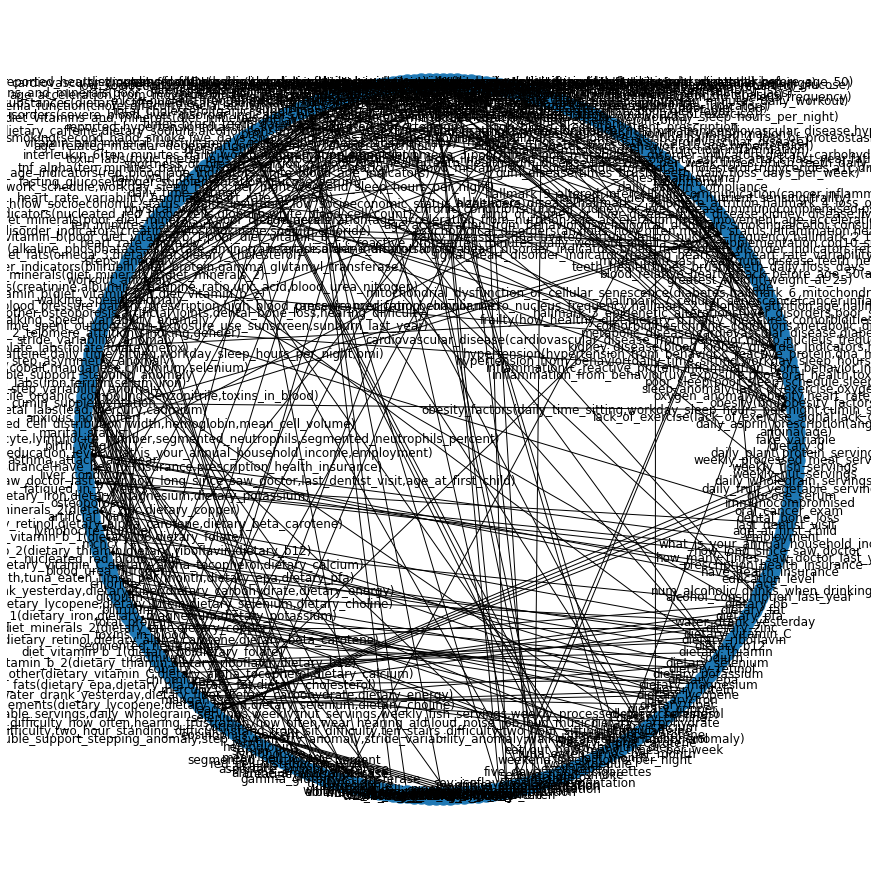

In [15]:
import matplotlib.pyplot as plt
plt.figure(3,figsize=(12,12)) 
#nx.draw(G, with_labels=True)  
#nx.draw_random(G, with_labels=True)   
nx.draw_circular(G, with_labels=True)  
#nx.draw_spectral(G, with_labels=True)   
#nx.draw_spring(G, with_labels=True)  

Here is the description of the Bayesian network in protobuf that we just created with the running of the python file.  The "leaves" have initial probabilities (DiscreteDistribution), and the conditional probabilities (ConditionalProbabilityTable) are to be computed:

In [16]:
bayesianNetwork

discreteDistributions {
  name: "fake_variable"
  variables {
    name: "fake_variable_1"
    probability: 0.05000000074505806
  }
  variables {
    name: "fake_variable_2"
    probability: 0.25
  }
  variables {
    name: "fake_variable_3"
    probability: 0.30000001192092896
  }
  variables {
    name: "fake_variable_4"
    probability: 0.20000000298023224
  }
  variables {
    name: "fake_variable_5"
    probability: 0.20000000298023224
  }
}
discreteDistributions {
  name: "age"
  variables {
    name: "elderly"
    probability: 0.05000000074505806
  }
  variables {
    name: "adult"
    probability: 0.25
  }
  variables {
    name: "young_adult"
    probability: 0.30000001192092896
  }
  variables {
    name: "teen"
    probability: 0.20000000298023224
  }
  variables {
    name: "child"
    probability: 0.20000000298023224
  }
}
discreteDistributions {
  name: "daily_aspirin_compliance"
  variables {
    name: "daily_aspirin_compliance_no"
    probability: 0.30000001192092896
  }

Here is the Pomegranate net we just made with the description.  Here we compile the net so we can compute probabilities with it.

In [17]:
from sn_bayes.utils import bayesInitialize
longevity = bayesInitialize(bayesianNetwork)

In [18]:
longevity.bake()

We we call a Pomegranate routine that shows the computed probabilities of every variable.  We have made our own utility that pulls out particular variables.

In [19]:
longevity.predict_proba({}) 

array([{
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "fake_variable_1" : 0.049999061191998345,
            "fake_variable_2" : 0.2500003770179417,
            "fake_variable_3" : 0.3000020040118213,
            "fake_variable_4" : 0.19999925915872355,
            "fake_variable_5" : 0.19999929861951518
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "elderly" : 0.049999307324181154,
            "adult" : 0.2499983584407459,
            "young_adult" : 0.3000013070719995,
            "teen" : 0.20000051518587358,
            "child" : 0.20000051197719992
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "daily_aspirin_compliance_no" : 0.30000

## Testing the Bayesian Network

Here we use our query util to enter patient states as evidence (evidence), and then see the probabilities of particular variables we are interested in (outvars), in this case, the output variables.    The query function needs the compiled Pomegranate Bayesian network as well as the description of the network.  In the following examples, we enter a particular patients state , one question at a time, to get a continual change in probability of all states.Adding more risk factors increases risk more.  

In [20]:
import sn_bayes
from sn_bayes.utils import query
evidence = {}
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09999968615653813,
  'no_hallmark_1_genomic_instability': 0.9000003138434619},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999993469969475,
  'no_hallmark_2_telomere_attrition': 0.9000000653003052},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18276880432222317,
  'no_hallmark_3_epigenetic_alterations': 0.8172311956777768},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.08520805080467579,
  'no_hallmark_4_loss_of_proteostasis': 0.9147919491953242},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.14992392011036423,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8500760798896357},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.06904198571838051,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9309580142816195},
 'hallmark_7_cellular_senescence': {'hal

In [21]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.12657072058379962,
  'no_hallmark_1_genomic_instability': 0.8734292794162004},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999994373525271,
  'no_hallmark_2_telomere_attrition': 0.9000000562647472},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18354827000410232,
  'no_hallmark_3_epigenetic_alterations': 0.8164517299958977},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.08524282117642865,
  'no_hallmark_4_loss_of_proteostasis': 0.9147571788235713},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.15304179414416236,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8469582058558376},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07324366989347354,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9267563301065265},
 'hallmark_7_cellular_senescence': {'hal

### Tests of increasingly poor patient state, showing gradual change of hallmarks

Below we test the bayesian net through the internal query, as it is done for efficiency in the app.  Note the internal query sends back all states not just the requested ones.  We also use query, so that we can see the results clearly in this notbook.    If most persons are of low socioeconomic status to begin with (65% in Nhanes data), then that would explain why the values only went up slightly even though the relative risk of poor diet given low socioeconomic status is 2.66.

In [22]:
import sn_bayes
from sn_bayes.utils import internal_query
evidence = {}
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.19 s, sys: 27 µs, total: 9.19 s
Wall time: 9.18 s


{'angina': {'angina_yes': 0.02999997415749798, 'angina_no': 0.970000025842502},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999999719296811,
  'daily_asprin_prescription_no': 0.9500000028070319},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13000000302675974,
  'blood_relative_heart_attack_before_50_no': 0.8699999969732403},
 'chest_pain': {'chest_pain_yes': 0.2999999860835063,
  'chest_pain_no': 0.7000000139164937},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000147655804,
  'no_greatest_weight_above_230.00': 0.749999998523442},
 'weight': {'weight_above_92.60': 0.2499997477585446,
  'no_weight_above_92.60': 0.7500002522414554},
 'height': {'height_above_173.40': 0.24999974053750454,
  'no_height_above_173.40': 0.7500002594624955},
 'hip': {'hip_above_112.70': 0.2499996249873083,
  'no_hip_above_112.70': 0.7500003750126917},
 'waist': {'waist_above_109.00': 0.2499998108693792,
  'no_waist_above_10

In [23]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.029999974110246345,
  'angina_no': 0.9700000258897536},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999999718453735,
  'daily_asprin_prescription_no': 0.9500000028154626},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13000000302081288,
  'blood_relative_heart_attack_before_50_no': 0.8699999969791872},
 'chest_pain': {'chest_pain_yes': 0.2999999860567904,
  'chest_pain_no': 0.7000000139432095},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765581,
  'no_greatest_weight_above_230.00': 0.7499999985234419},
 'weight': {'weight_above_92.60': 0.24999975237423322,
  'no_weight_above_92.60': 0.7500002476257669},
 'height': {'height_above_173.40': 0.2499997452559906,
  'no_height_above_173.40': 0.7500002547440094},
 'hip': {'hip_above_112.70': 0.24999963187138077,
  'no_hip_above_112.70': 0.7500003681286193},
 'waist': {'waist_above_109.00': 0.24999981443434527,
  'no_waist_ab

 Below we see that frailty affects the hallmarks more strongly, including increases in hallmark 3, while 8 and 5 are actually flipped on.  When cancer is added,  hallmarks 7 and 9 flip on.

In [24]:
evidence = {}
evidence["frailty"] = "frailty"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.03025595104621881,
  'angina_no': 0.9697440489537812},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.0500635091893304,
  'daily_asprin_prescription_no': 0.9499364908106697},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1300753422145182,
  'blood_relative_heart_attack_before_50_no': 0.8699246577854819},
 'chest_pain': {'chest_pain_yes': 0.3002215240020991,
  'chest_pain_no': 0.6997784759979009},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000151599877,
  'no_greatest_weight_above_230.00': 0.7499999984840012},
 'weight': {'weight_above_92.60': 0.25349594568687145,
  'no_weight_above_92.60': 0.7465040543131285},
 'height': {'height_above_173.40': 0.2535752828215355,
  'no_height_above_173.40': 0.7464247171784644},
 'hip': {'hip_above_112.70': 0.2552066169249948,
  'no_hip_above_112.70': 0.7447933830750052},
 'waist': {'waist_above_109.00': 0.25269628886101014,
  'no_waist_above

In [25]:
evidence["cancer"] = "cancer"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.03672597558875853,
  'angina_no': 0.9632740244112415},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05123474751624425,
  'daily_asprin_prescription_no': 0.9487652524837557},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13092923477007604,
  'blood_relative_heart_attack_before_50_no': 0.8690707652299239},
 'chest_pain': {'chest_pain_yes': 0.3039492325182103,
  'chest_pain_no': 0.6960507674817896},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000015364782,
  'no_greatest_weight_above_230.00': 0.7499999984635218},
 'weight': {'weight_above_92.60': 0.25529782785549093,
  'no_weight_above_92.60': 0.7447021721445092},
 'height': {'height_above_173.40': 0.25541839752616385,
  'no_height_above_173.40': 0.7445816024738362},
 'hip': {'hip_above_112.70': 0.25788949688347823,
  'no_hip_above_112.70': 0.7421105031165217},
 'waist': {'waist_above_109.00': 0.25408563742325385,
  'no_waist_ab

In [26]:
#we show some of the same results as in the last cell for clarity
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.5316556674353939,
  'no_hallmark_1_genomic_instability': 0.468344332564606},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.19975036316980413,
  'no_hallmark_2_telomere_attrition': 0.8002496368301958},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.8747488951412841,
  'no_hallmark_3_epigenetic_alterations': 0.12525110485871596},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.1173884189780591,
  'no_hallmark_4_loss_of_proteostasis': 0.8826115810219409},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 1.0,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.0},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.08296145199905555,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9170385480009444},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 1.0,

## Testing Explanations

The explain function will tell you which nodes, whether inner or leaf, when changed, change the output variable.  A variable is on the reverse explain list if we want to know what changes to other variables will increase it.  Otherwise we look to 
changes that decrease the variable to be explained.  One may select which explanations are relevant for their purposes, as this is just a measure of dependence. The point is to find out which variables help a situation, where the output variables are the goals.  At default values,  we want to find out how to decrease an output_variables probability, when we move a variable from where it is to one value to the right.  Our present rules, in longevity_bayes.py, are designed so that one value to the right is an improvement.  The explanation output tells you the change in the probability of the output variable when this happens.  Those explanations with the greatest values tell the variables that when you improve them decrease the probability of the output variable the most, and are thus the most helpful in decreasing the chance of a bad thing.  However, some variables could possibly need to additionally be on the reverse_explain_list because they are not bad things, they are good things, so as a goal, you would want to know how to increase their probability not decrease it.  So, to find an explanation for why an indicator is so good, you have to enter all the nodes of the net into reverse_evidence that were not in reverse_evidence when explainng why an indicator is doing poorly.

Although we need the explain function for complex rule sets in which the direction of the rules  changes at times because there are different and multiple goals, we have made two wrapper functions that only apply for rulesets in which all the rules are in the same direction, for example the covid ruleset and the longevity ruleset.  One wrapper is explain_why_bad, which takes on the default of the explain function, and has no reverse_explain_list or reverse_evidence.  The other is explain_why_good, explained below.  explain_why_good (and explain using reverse evidence and explain vars only works when the result is actually good, and explain_why_bad (and the explain default) only works when a result is actually bad.  Below we show only the explain why good and explain why bad functions for explanations, because the longevity_bayes.py file only has rules that are expressed as negative states.

In [27]:
#include_list = ["heart_rate_variability_anomaly","oxygen_anomaly","lack_of_exercise","uv_exposure","blood_age_indicators","poor_sleep","inflammation_from_behavior","poor_diet","smoking","frailty_signals","cancer","frailty","liver_disorders","cardiovascular_disease","inactivated_sirtuins","inflammation","sarcopenia","comorbidities","general_aging_signs","blood_metabolism_disorder_indicators","obesity","hypertension","diabetes","metabolic_disease","gender"]


In [28]:
include_list = ["age_related_macular_degeneration","alzheimers_disease","parkinsons_disease","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]

In [29]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.385083928704262 seconds


### Explanations

To pull out explanations, the algorithm has changed as a result of the new less computationally complex algorithm.  First, find the majority explanation value for an output variable, and then get rid of all candidate explanations that have that value or below. Then, of the remaining, use a threshold of 0.1 and above to include an explanation.  Then you can rank them by the magnitude, to find the stronger explanations, perhaps to show those nearer to the top.  Below, for example, we have preinted out the why bad, and then the why good. Typically if the results are good, and you ask why they are bad, you will not get an answer and visa versa.  We see that cancer is an explaination fo rwhy hallmark 7 and 9 are bad, and frailty explains 8 and 5.   



In [30]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'frailty': 0.20674561173241118, 'cancer': 0.20674561173241118, 'lack_of_exercise_reported': -0.04325439170896894, 'uv_exposure': 0.20674561312939516, 'diet_vitamins_and_minerals': 0.20674561173241118, 'diet_fats': 0.20674561173241118, 'diet_basics': 0.20674561173241118, 'diet_quality_food': 0.20674561173241118, 'diet_quantity': 0.20674561173241118, 'diet_quality': 0.20674561173241118, 'inactivated_sirtuins': 0.20674561173241118, 'lung_or_kidney_or_liver_disease': 0.20674561173241118, 'chronic_conditions': 0.20674561173241118}, 'obesity': {'frailty': 0.15290353660282086, 'cancer': 0.15290353660282086, 'lack_of_exercise_reported': 0.15290353660282086, 'uv_exposure': 0.15290353660282086, 'diet_vitamins_and_minerals': 0.15290353660282086, 'diet_fats': 0.15290353660282086, 'diet_basics': 0.15290353660282086, 'diet_quality_food': 0.15290353660282086, 'diet_quantity': 0.15290353660282086, 'diet_quality': 0.15290353660282086, 'inactivated_sirtuins': 0.15290353660282086, '

In [31]:
evidence = {}
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 9.76 s, sys: 3.99 ms, total: 9.76 s
Wall time: 9.76 s


{'angina': {'angina_yes': 0.03360615561804451,
  'angina_no': 0.9663938443819555},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.050643958147174664,
  'daily_asprin_prescription_no': 0.9493560418528253},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1304551521185024,
  'blood_relative_heart_attack_before_50_no': 0.8695448478814976},
 'chest_pain': {'chest_pain_yes': 0.30204122086167895,
  'chest_pain_no': 0.697958779138321},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765588,
  'no_greatest_weight_above_230.00': 0.7499999985234412},
 'weight': {'weight_above_92.60': 0.24999978537781295,
  'no_weight_above_92.60': 0.750000214622187},
 'height': {'height_above_173.40': 0.2499997793373291,
  'no_height_above_173.40': 0.750000220662671},
 'hip': {'hip_above_112.70': 0.2499996791989015,
  'no_hip_above_112.70': 0.7500003208010986},
 'waist': {'waist_above_109.00': 0.2499998389432402,
  'no_waist_above_1

### Realistic survey answers

The above example is simple for understanding's sake, it just has 2 inputs, one of which is in the questions (cancer) and one which is not, but is affected by the questions that are inputs (frailty).  So next we will have the input that is more like the answers to the surveys, and see if they still produce correct results

In [32]:
evidence = {"age":"adult",
"daily_aspirin_compliance":"daily_aspirin_compliance_yes",
"high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
"high_blood_pressure_medication_compliance":"high_blood_pressure_medication_compliance_yes",
"diastolic":"diastolic_80_to_89_high_stage_1",
"systolic":"systolic_less_than_120_normal",
"sun_exposure_half_hour":"sun_exposure_half_hour_mild_burn_tanning",
"time_spent_outdoors":"time_spent_outdoors_none",
"sun_exposure_use_sunscreen":"sun_exposure_use_sunscreen_sometimes",
"sunburn_last_year":"sunburn_last_year_yes",
"weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
"bmi":"bmi_over_40_high_risk",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below",
"shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours",
"physical_work":"physical_work_no",
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no",
"heart_rate_anomaly":"heart_rate_anomaly",
"steps_anomaly":"steps_anomaly",
"workout_anomaly":"workout_anomaly",
"walking_speed_anomaly":"walking_speed_anomaly",
"walking_speed_variability_anomaly":"walking_speed_variability_anomaly",
"stride_variability_anomaly":"no_stride_variability_anomaly",
"step_asymmetry_anomaly":"no_step_asymmetry_anomaly",
"double_support_stepping_anomaly":"double_support_stepping__anomaly",
"step_variability_anomaly":"step_variability_anomaly",
"anxious_how_often":"anxious_daily",
"marital_status":"divorced",
"asthma_attack_last_year":"asthma_attack_last_year_no",
"liver_condition":"liver_condition_yes",
"fatiqued_in_2_weeks":"fatiqued_in_2_weeks_nearly_everyday",
"osteoporosis":"osteoporosis_no",
"artificial_joints":"artificial_joints_no",
"work_limiting_problem":"work_limiting_problem_yes",
"ten_stairs_difficulty":"ten_stairs_difficulty_some",
"chore_difficulty":"chore_difficulty_some",
"walking_difficulty":"walking_difficulty_much",
"stand_from_sit_difficulty":"stand_from_sit_difficulty_much",
"two_hour_standing_difficulty":"two_hour_standing_difficulty_much",
"two_hour_sitting_difficulty":"two_hour_sitting_difficulty_none",
"social_activity_difficulty":"social_activity_difficulty_much",
"urine_leakage_bother":"urine_leakage_bother_somewhat",
"hearing_difficulty_how_often":"hearing_difficulty_usually",
"hearing_frustration_how_often":"hearing_frustration_usually",
"wear_hearing_aid":"wear_hearing_aid_no",
"loud_noise_job":"loud_noise_job_no",
"loud_music":"loud_music_yes",
"second_hand_smoke":"second_hand_smoke_no",
"five_days_smoke_cigarettes":"five_days_smoke_cigarettes_no",
"ever_vaped":"ever_vaped_no",
"gender":"female",
"work_schedule":"work_schedule_evenings_or_nights",
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"weekend_sleep_hours_per_night":"weekend_sleep_5.0_to_6.5",
"fish_last_month":"fish_last_month_no",
"tuna_eaten_times_per_month":"tuna_eaten_per_month_0_or_1",
"eat_out_how_many_times_per_week":"eat_out_more_than_7_times_per_week",
"how_healthy_diet":"how_healthy_diet_fair",
"alcohol_consumption_last_year":"alcohol_never",
"race":"race_white",
"education_level":"education_level_at_least_some_college",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes",
"how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
"how_long_since_saw_doctor":"saw_doctor_less_than_6_months_ago",
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working",
"age_at_first_child":"age_at_first_child_20_through_24",
"last_dentist_visit":"last_dentist_visit_6_months_or_less",
"dental_bone_loss":"dental_bone_loss_no",
"oral_cancer_exam":"oral_cancer_exam_no",
"lung_disease":"no_lung_disease",
"immunocompromised":"not_immunocompromised",
"angina":"angina_no",
"daily_asprin_prescription":"daily_asprin_prescription_no",
"blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
"chest_pain":"chest_pain_no",
"greatest_weight":"greatest_weight_above_230.00",
"weight":"weight_above_92.60",
"height":"no_height_above_173.40",
"lack_of_exercise_reported":"lack_of_exercise_reported",
"salt_how_often":"salt_very_often",
"times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
"floss_days_per_week":"no_floss_days_per_week_3_or_less",
"teeth_health":"teeth_health_poor",
"gum_disease":"gum_disease_yes",
"mouth_pain_last_year":"mouth_pain_last_year_fairly_often",
"sleep_anomaly":"sleep_anomaly"}

In [33]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.37 s, sys: 13 µs, total: 8.37 s
Wall time: 8.37 s


{'angina': {'angina_yes': 1e-05, 'angina_no': 0.99999},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 1.0,
  'no_lack_of_workout_reported': 0.0},
 'lack_of_exercise_reported': {'lack_of_exercise_

In [34]:
from sn_bayes.utils import query
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14565011835853953,
  'no_hallmark_1_genomic_instability': 0.8543498816414605},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08828568648603755,
  'no_hallmark_2_telomere_attrition': 0.9117143135139625},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.4615568953049922,
  'no_hallmark_3_epigenetic_alterations': 0.5384431046950079},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.18069842872922268,
  'no_hallmark_4_loss_of_proteostasis': 0.8193015712707773},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.19781468836456587,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8021853116354342},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.25917727507144017,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7408227249285598},
 'hallmark_7_cellular_senescence': {'hall

In [35]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 22.647377564571798 seconds


In [36]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'daily_walk_or_bicycle_travel': 0.10091407426628896, 'daily_time_sitting': 0.1009140730090008, 'ten_minutes_daily_workout': 0.10091407426628896, 'heart_rate_anomaly': 0.10091407426628873, 'steps_anomaly': 0.10091408112093303, 'workout_anomaly': 0.10091407426628896, 'step_variability_anomaly': 0.10091407426628896, 'anxious_how_often': 0.10091407426628896, 'marital_status': 0.10091407426628896, 'eat_out_how_many_times_per_week': 0.10091407426628896, 'lack_of_exercise_reported': 0.5025288217136767, 'sleep_anomaly': 0.2766059180293412, 'obesity': 0.10091407426628896, 'liver_disorders': 0.10091407426628896, 'uv_exposure': 0.10091407375929318, 'poor_oral_health': 0.10091407375929318, 'inflammation_from_illness': 0.10091407426628896, 'c_reactive_protein': 0.10091407426628896, 'poor_sleep_schedule': 0.10091407426628896, 'poor_sleep': 0.10091407375929318, 'inflammation_from_behavior': 0.14410024003594302, 'diet_vitamins_and_minerals': 0.10091407426628896, 'diet_fats': 0.10

## One by One Survey Example (Apple Health + Apple Watch)

In order to sync the app with the notebook, do not turn on signals when testing in the following cells.  Signals are tested at the bottom of the notebook

In [37]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]



In [38]:
#first, biometric survey                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         
evidence = {"age": "adult",
        "bmi": "bmi_over_40_high_risk",
        "cancer": "no_cancer",
        "gender": "female",
        "height": "no_height_above_173.40",
        "weight": "weight_above_92.60",
        "diabetes": "no_diabetes",
        "systolic": "systolic_130_to_139_high_stage_1",
        "diastolic": "diastolic_80_to_89_high_stage_1",
        "hypertension": "no_hypertension",
        "lung_disease": "no_lung_disease",
        "kidney_disease": "no_kidney_disease",
        "immunocompromised": "not_immunocompromised",
        "alzheimers_disease": "no_alzheimers_disease",
        "parkinsons_disease": "no_parkinsons_disease",
        "resting_heart_rate": "no_resting_heart_rate_very_high_91_and_above",
        "cardiovascular_disease": "no_cardiovascular_disease",
        "psychological_disorders": "no_psychological_disorders",
        "age_related_macular_degeneration": "no_age_related_macular_degeneration"}
            

In [39]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 14 s, sys: 3.99 ms, total: 14.1 s
Wall time: 14 s


{'angina': {'angina_yes': 0.030586396467757338,
  'angina_no': 0.9694136035322427},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049812465254299804,
  'daily_asprin_prescription_no': 0.9501875347457001},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12936812613464083,
  'blood_relative_heart_attack_before_50_no': 0.8706318738653592},
 'chest_pain': {'chest_pain_yes': 0.2990751442915195,
  'chest_pain_no': 0.7009248557084805},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [40]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.12657172769583006,
  'no_hallmark_1_genomic_instability': 0.87342827230417},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08093989019407279,
  'no_hallmark_2_telomere_attrition': 0.9190601098059272},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.15344310530663452,
  'no_hallmark_3_epigenetic_alterations': 0.8465568946933655},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1465510024653642,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8534489975346358},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.062479332191083016,
  'no_hallmark_6_mitochondrial_dysfunction': 0.937520667808917},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.06

In [41]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.260913635604084 seconds


In [42]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.2299720130512083, 'obesity': 0.2299720130512083, 'diet_fats': 0.2299720130512083, 'diet_quality_food': 0.2299720130512083, 'diet_quantity': 0.2299720130512083, 'diet_quality': 0.2299720130512083, 'inactivated_sirtuins': 0.2299720130512083}, 'obesity': {'bmi': 0.5924712706776659, 'diet_fats': -0.009847521822148098, 'diet_quality_food': -0.009847521822148098, 'diet_quantity': -0.009847521822148098, 'diet_quality': -0.009847521822148098, 'inactivated_sirtuins': -0.009847521822148098}, 'smoking': {'bmi': 0.23634272231942433, 'obesity': 0.23634272231942433, 'diet_fats': 0.23634272231942433, 'diet_quality_food': 0.23634272231942433, 'diet_quantity': 0.23634272231942433, 'diet_quality': 0.23634272231942433, 'inactivated_sirtuins': 0.23634272231942433}, 'poor_sleep': {'bmi': 0.5108300049677731, 'obesity': 0.5108300049677731, 'diet_fats': 0.5108300049677731, 'diet_quality_food': 0.5108300049677731, 'diet_quantity': 0.5108300049677731, 'diet_quality': 0.51083000496

In [43]:
#add daily checkin
evidence.update(
    {
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"water_drank_yesterday":"water_drank_yesterday_above_870.00_to_1633.50_and_below",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below" ,
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours" ,         
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no"
    }
)

In [44]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 15.9 s, sys: 3.99 ms, total: 15.9 s
Wall time: 15.9 s


{'angina': {'angina_yes': 0.030598830657587034,
  'angina_no': 0.9694011693424128},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049825087982510036,
  'daily_asprin_prescription_no': 0.95017491201749},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1293948369422884,
  'blood_relative_heart_attack_before_50_no': 0.8706051630577115},
 'chest_pain': {'chest_pain_yes': 0.29912695841592607,
  'chest_pain_no': 0.7008730415840739},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_repor

In [45]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.11816203789891352,
  'no_hallmark_1_genomic_instability': 0.8818379621010866},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08030408384273643,
  'no_hallmark_2_telomere_attrition': 0.9196959161572635},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2212266971611338,
  'no_hallmark_3_epigenetic_alterations': 0.778773302838866},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.159706783456455,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.840293216543545},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.10376657545779264,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8962334245422073},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.1037

In [46]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.423249981366098 seconds


In [47]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.01439907349417413, 'dietary_energy': -0.01439907349417413, 'daily_walk_or_bicycle_travel': -0.01439907349417413, 'daily_time_sitting': -0.014399059605184727, 'ten_minutes_daily_workout': -0.01439907349417413, 'lack_of_exercise_reported': -0.2585350044218141, 'obesity': -0.01439907349417413, 'c_reactive_protein': -0.01439907349417413, 'poor_sleep_schedule': -0.01439907349417413, 'poor_sleep': -0.014399072099902543, 'diet_fats': -0.01439907349417413, 'diet_basics': -0.01439907349417413, 'diet_quality_food': -0.01439907349417413, 'diet_quantity': -0.01439907349417413, 'diet_quality': -0.01439907349417413, 'inactivated_sirtuins': -0.01439907349417413}, 'obesity': {'bmi': 0.6303992596375714, 'dietary_energy': 0.028080470551536063, 'daily_walk_or_bicycle_travel': 0.028080470551536063, 'daily_time_sitting': 0.028080476532480025, 'ten_minutes_daily_workout': 0.028080470551536063, 'lack_of_exercise_reported': 0.028080470551536063, 'c_reactive_protein': 0.02808047

In [48]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [49]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.8 s, sys: 12 ms, total: 13.8 s
Wall time: 13.8 s


{'angina': {'angina_yes': 0.030599542759615805,
  'angina_no': 0.9694004572403843},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049825810826535734,
  'daily_asprin_prescription_no': 0.9501741891734643},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12939636649168257,
  'blood_relative_heart_attack_before_50_no': 0.8706036335083175},
 'chest_pain': {'chest_pain_yes': 0.2991299254608291,
  'chest_pain_no': 0.7008700745391709},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [50]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10297996644724083,
  'no_hallmark_1_genomic_instability': 0.8970200335527592},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08000361672612101,
  'no_hallmark_2_telomere_attrition': 0.919996383273879},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2601062171349775,
  'no_hallmark_3_epigenetic_alterations': 0.7398937828650226},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1582810537354586,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8417189462645414},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.10962211975672238,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8903778802432776},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.10

In [51]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.14149819780141 seconds


In [52]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.014429316361688649, 'dietary_energy': -0.014429316361688649, 'daily_walk_or_bicycle_travel': -0.014429316361688649, 'daily_time_sitting': -0.014429302472699246, 'ten_minutes_daily_workout': -0.014429316361688649, 'marital_status': -0.014429316361688649, 'lack_of_exercise_reported': -0.2585652472893286, 'obesity': -0.014429316361688649, 'c_reactive_protein': -0.014429316361688649, 'poor_sleep_schedule': -0.014429316361688649, 'poor_sleep': -0.014429314967417062, 'diet_fats': -0.014429316361688649, 'diet_basics': -0.014429316361688649, 'diet_quality_food': -0.014429316361688649, 'diet_quantity': -0.014429316361688649, 'diet_quality': -0.014429316361688649, 'inactivated_sirtuins': -0.014429316361688649}, 'obesity': {'bmi': 0.6303829596412791, 'dietary_energy': 0.028064170555243795, 'daily_walk_or_bicycle_travel': 0.028064170555243795, 'daily_time_sitting': 0.028064176536187757, 'ten_minutes_daily_workout': 0.028064170555243795, 'marital_status': 0.028064170

In [53]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [54]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.7 s, sys: 4 ms, total: 13.7 s
Wall time: 13.7 s


{'angina': {'angina_yes': 0.030599542759615805,
  'angina_no': 0.9694004572403843},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049825810826535734,
  'daily_asprin_prescription_no': 0.9501741891734643},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12939636649168257,
  'blood_relative_heart_attack_before_50_no': 0.8706036335083175},
 'chest_pain': {'chest_pain_yes': 0.2991299254608291,
  'chest_pain_no': 0.7008700745391709},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [55]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10297996644724083,
  'no_hallmark_1_genomic_instability': 0.8970200335527592},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08000361672612101,
  'no_hallmark_2_telomere_attrition': 0.919996383273879},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2601062171349775,
  'no_hallmark_3_epigenetic_alterations': 0.7398937828650226},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1582810537354586,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8417189462645414},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.10962211975672238,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8903778802432776},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.10

In [56]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.165291051380336 seconds


In [57]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.014429316361688649, 'dietary_energy': -0.014429316361688649, 'daily_walk_or_bicycle_travel': -0.014429316361688649, 'daily_time_sitting': -0.014429302472699246, 'ten_minutes_daily_workout': -0.014429316361688649, 'marital_status': -0.014429316361688649, 'lack_of_exercise_reported': -0.2585652472893286, 'obesity': -0.014429316361688649, 'c_reactive_protein': -0.014429316361688649, 'poor_sleep_schedule': -0.014429316361688649, 'poor_sleep': -0.014429314967417062, 'diet_fats': -0.014429316361688649, 'diet_basics': -0.014429316361688649, 'diet_quality_food': -0.014429316361688649, 'diet_quantity': -0.014429316361688649, 'diet_quality': -0.014429316361688649, 'inactivated_sirtuins': -0.014429316361688649}, 'obesity': {'bmi': 0.6303829596412791, 'dietary_energy': 0.028064170555243795, 'daily_walk_or_bicycle_travel': 0.028064170555243795, 'daily_time_sitting': 0.028064176536187757, 'ten_minutes_daily_workout': 0.028064170555243795, 'marital_status': 0.028064170

In [58]:
#add general medical history survey
evidence.update(
    {
        "how_long_since_saw_doctor":"saw_doctor_6_to_12_months_ago",
        "how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
        "birth_weight":"birth_weight_7_to_8_lbs",
        "greatest_weight":"greatest_weight_above_230.00",
        "weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
        "daily_asprin_prescription":"daily_asprin_prescription_no",
        "daily_aspirin_compliance":"daily_aspirin_compliance_no",
        "shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
        "work_limiting_problem":"work_limiting_problem_no",
        "anxious_how_often":"anxious_daily",
        "fatiqued_in_2_weeks":"fatiqued_in_2_weeks_more_than_half_the_days",
        "chest_pain":"chest_pain_no",
        "liver_condition":"liver_condition_yes",
        "osteoporosis":"osteoporosis_no",
        "asthma_attack_last_year":"asthma_attack_last_year_no",
        "high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
        "blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
        "urine_leakage_bother":"urine_leakage_bother_somewhat",
        "artificial_joints":"artificial_joints_yes",
        "hearing_difficulty_how_often":"hearing_difficulty_usually",
        "hearing_frustration_how_often":"hearing_frustration_usually",
        "wear_hearing_aid":"wear_hearing_aid_no",
        "loud_noise_job":"loud_noise_job_no",
        "loud_music":"loud_music_yes",
        "age_at_first_child":"age_at_first_child_20_through_24",
        "last_dentist_visit":"last_dentist_visit_7_months_to_a_year",
        "times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
        "floss_days_per_week":"no_floss_days_per_week_3_or_less",
        "teeth_health":"no_teeth_health_poor",
        "gum_disease":"gum_disease_yes",
        "oral_cancer_exam":"oral_cancer_exam_no",
        "dental_bone_loss":"dental_bone_loss_no",
        "mouth_pain_last_year":"mouth_pain_last_year_fairly_often"
        
    }
)

In [59]:

import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.7 s, sys: 4 ms, total: 13.7 s
Wall time: 13.7 s


{'angina': {'angina_yes': 0.004625752436758274,
  'angina_no': 0.9953742475632417},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [60]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09362119987818981,
  'no_hallmark_1_genomic_instability': 0.9063788001218103},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.0793645723995842,
  'no_hallmark_2_telomere_attrition': 0.9206354276004158},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.3364719382922094,
  'no_hallmark_3_epigenetic_alterations': 0.6635280617077907},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16502556188841977,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8349744381115802},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.2103006461249948,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7896993538750051},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.21

In [61]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.474569239653647 seconds


In [62]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.019227343157051102, 'dietary_energy': -0.019227343157051102, 'daily_walk_or_bicycle_travel': -0.019227343157051102, 'daily_time_sitting': -0.0192273292680617, 'ten_minutes_daily_workout': -0.019227343157051102, 'marital_status': -0.019227343157051102, 'anxious_how_often': -0.019227343157051102, 'lack_of_exercise_reported': -0.2633632744778567, 'obesity': -0.019227343157051102, 'liver_disorders': -0.019227343157051102, 'poor_oral_health': -0.019227341762779626, 'inflammation_from_illness': -0.019227343157051102, 'c_reactive_protein': -0.019227343157051102, 'poor_sleep_schedule': -0.019227343157051102, 'poor_sleep': -0.019227341762779626, 'inflammation_from_behavior': -0.11816132222584341, 'diet_fats': -0.019227343157051102, 'diet_basics': -0.019227343157051102, 'diet_quality_food': -0.019227343157051102, 'diet_quantity': -0.019227343157051102, 'diet_quality': -0.019227343157051102, 'inactivated_sirtuins': -0.019227343157051102, 'lung_or_kidney_or_liver_di

In this example, we see that the values of all of the hallmarks and recommendations are positive.   Therefore, the only insights are from the explanation of why so good. The user is doing well with 3 and 5 because there are no signs of frailty, and 4 because there is no problems with cardiovascular disease, and 6 because there is no problem with inflammation.  Hallmark 7 is good because of a lack of inflammation or cancer, 8 because no inflammation or frailty, and 9 no inflammation or cancer.  Hallmark 10 is good because there is no inflammation, cander, or cardiovascular disease.   There are two health recommendations given.  For explaining why bad, we see that lack of exercise has the explanation that it was reported, and a sleep anomaly explains the need for a poor sleep recommendation.  For explaining why good we see that diet quality and lack of inflammation from diet are why the user does not have problems with a poor diet.  The user is doing good with smoking as the result of reported smoking.


In [63]:
evidence1 = evidence.copy()
evidence1['diabetes']=  'diabetes'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 14.9 s, sys: 4.01 ms, total: 14.9 s
Wall time: 14.9 s


{'angina': {'angina_yes': 0.004546048408282699,
  'angina_no': 0.9954539515917173},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [64]:
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 13.4 s, sys: 3.99 ms, total: 13.4 s
Wall time: 13.4 s


{'angina': {'angina_yes': 0.004612955533861733,
  'angina_no': 0.9953870444661382},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [65]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.755279093049467 seconds


In [66]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.018483658470624276, 'dietary_energy': -0.018483658470624276, 'daily_walk_or_bicycle_travel': -0.018483658470624276, 'daily_time_sitting': -0.018483644581634873, 'ten_minutes_daily_workout': -0.018483658470624276, 'marital_status': -0.018483658470624276, 'anxious_how_often': -0.018483658470624276, 'lack_of_exercise_reported': -0.26261958979142985, 'obesity': -0.018483658470624276, 'liver_disorders': -0.018483658470624276, 'poor_oral_health': -0.0184836570763528, 'inflammation_from_illness': -0.018483658470624276, 'c_reactive_protein': -0.018483658470624276, 'poor_sleep_schedule': -0.018483658470624276, 'poor_sleep': -0.0184836570763528, 'inflammation_from_behavior': -0.11741763753941659, 'diet_vitamins_and_minerals': -0.018483658470624276, 'diet_fats': -0.018483658470624276, 'diet_basics': -0.018483658470624276, 'diet_quality_food': -0.018483658470624276, 'diet_quantity': -0.018483658470624276, 'diet_quality': -0.018483658470624276, 'inactivated_sirtuins'

In [67]:
evidence1 = evidence.copy()
evidence1['age']=  'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result



CPU times: user 14.2 s, sys: 7.98 ms, total: 14.2 s
Wall time: 14.2 s


{'angina': {'angina_yes': 0.009976287743962482,
  'angina_no': 0.9900237122560375},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [68]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence1,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.06981574177020788,
  'no_hallmark_1_genomic_instability': 0.9301842582297921},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09577933972535595,
  'no_hallmark_2_telomere_attrition': 0.9042206602746442},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.053634820285554184,
  'no_hallmark_3_epigenetic_alterations': 0.9463651797144458},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.12309913918057286,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8769008608194272},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.20072669022494016,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7992733097750598},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 

In [69]:
evidence ={}
evidence['age']= 'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result


CPU times: user 9.44 s, sys: 4.02 ms, total: 9.44 s
Wall time: 9.43 s


{'angina': {'angina_yes': 0.06478873826209772,
  'angina_no': 0.9352112617379024},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227629338063,
  'daily_asprin_prescription_no': 0.9437877237066193},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081767379643,
  'blood_relative_heart_attack_before_50_no': 0.8656091823262035},
 'chest_pain': {'chest_pain_yes': 0.3196917392457589,
  'chest_pain_no': 0.6803082607542411},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000147655876,
  'no_greatest_weight_above_230.00': 0.7499999985234411},
 'weight': {'weight_above_92.60': 0.24999978623411995,
  'no_weight_above_92.60': 0.75000021376588},
 'height': {'height_above_173.40': 0.2499997802114579,
  'no_height_above_173.40': 0.750000219788542},
 'hip': {'hip_above_112.70': 0.24999968048295185,
  'no_hip_above_112.70': 0.7500003195170482},
 'waist': {'waist_above_109.00': 0.24999983960819483,
  'no_waist_above

In [70]:
import sn_bayes
from sn_bayes.utils import query
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436699517669674,
  'no_hallmark_1_genomic_instability': 0.8556330048233033},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.0999999447170534,
  'no_hallmark_2_telomere_attrition': 0.9000000552829466},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18639765559966615,
  'no_hallmark_3_epigenetic_alterations': 0.8136023444003339},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.1670612346938106,
  'no_hallmark_4_loss_of_proteostasis': 0.8329387653061894},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16443924675602406,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8355607532439759},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07090807130958866,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9290919286904114},
 'hallmark_7_cellular_senescence': {'hallm

In [71]:
evidence ={}
evidence['lack_of_exercise_reported']= 'no_lack_of_exercise_reported'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.75 s, sys: 12 ms, total: 8.76 s
Wall time: 8.75 s


{'angina': {'angina_yes': 0.029999973083885804,
  'angina_no': 0.9700000269161142},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999999700127038,
  'daily_asprin_prescription_no': 0.9500000029987296},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13000000289130056,
  'blood_relative_heart_attack_before_50_no': 0.8699999971086995},
 'chest_pain': {'chest_pain_yes': 0.29999998547588197,
  'chest_pain_no': 0.700000014524118},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765578,
  'no_greatest_weight_above_230.00': 0.7499999985234421},
 'weight': {'weight_above_92.60': 0.24999972401812542,
  'no_weight_above_92.60': 0.7500002759818747},
 'height': {'height_above_173.40': 0.24999971631319626,
  'no_height_above_173.40': 0.7500002836868037},
 'hip': {'hip_above_112.70': 0.2499995896333615,
  'no_hip_above_112.70': 0.7500004103666384},
 'waist': {'waist_above_109.00': 0.24999979256108518,
  'no_waist_ab

In [72]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09999964585097178,
  'no_hallmark_1_genomic_instability': 0.9000003541490281},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999992987199051,
  'no_hallmark_2_telomere_attrition': 0.9000000701280095},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.181010675469333,
  'no_hallmark_3_epigenetic_alterations': 0.8189893245306671},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.08203806683815715,
  'no_hallmark_4_loss_of_proteostasis': 0.9179619331618428},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.14875521152006893,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.851244788479931},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.05516488241164543,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9448351175883545},
 'hallmark_7_cellular_senescence': {'hallma

## Beta Tester Surveys

In [73]:
tester1_4=  {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "fish_last_month": "fish_last_month_yes", "chore_difficulty": "chore_difficulty_some", "how_healthy_diet": "how_healthy_diet_excellent", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "water_drank_yesterday": "water_drank_yesterday_above_1633.50", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "tuna_eaten_times_per_month": "tuna_eaten_per_month_8_or_more", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_under_5_no", "eat_out_how_many_times_per_week": "eat_out_1_or_2_times_per_week"}
evidence = tester1_4               
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result
        

CPU times: user 9.16 s, sys: 3.99 ms, total: 9.16 s
Wall time: 9.15 s


{'angina': {'angina_yes': 0.0647887382413196, 'angina_no': 0.9352112617586804},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.0562122762802999,
  'daily_asprin_prescription_no': 0.9437877237197001},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1343908176500276,
  'blood_relative_heart_attack_before_50_no': 0.8656091823499724},
 'chest_pain': {'chest_pain_yes': 0.31969173919769045,
  'chest_pain_no': 0.6803082608023096},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_above_10

In [74]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.13928331218591092,
  'no_hallmark_1_genomic_instability': 0.8607166878140892},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830307233484336,
  'no_hallmark_2_telomere_attrition': 0.8916969276651566},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.16487799592337238,
  'no_hallmark_3_epigenetic_alterations': 0.8351220040766276},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.18825780586129787,
  'no_hallmark_4_loss_of_proteostasis': 0.8117421941387021},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.11738409057408082,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8826159094259193},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.1083478240663087,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8916521759336914},
 'hallmark_7_cellular_senescence': {'hall

In [75]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.354479215107858 seconds


In [76]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.024999755897135767, 'daily_time_sitting': 0.02499974086354073, 'ten_minutes_daily_workout': 0.024999755897135767, 'daily_walk_or_bicycle_travel': 0.024999755897135767, 'eat_out_how_many_times_per_week': 0.024999755897135767, 'lack_of_exercise_reported': 0.27499975940881355, 'obesity': 0.024999755897135767, 'c_reactive_protein': 0.024999755897135767, 'diet_fats': 0.024999755897135767, 'diet_quality_food': 0.024999755897135767, 'hypertension': 0.024999755897135767, 'inactivated_sirtuins': 0.024999755897135767, 'chronic_conditions': 0.024999755897135767, 'comorbidities': 0.024999755897135767}, 'obesity': {'gender': 0.25822421159108816, 'daily_time_sitting': 0.25822420818839176, 'ten_minutes_daily_workout': 0.25822421159108816, 'daily_walk_or_bicycle_travel': 0.25822421159108816, 'eat_out_how_many_times_per_week': 0.25822421159108816, 'lack_of_exercise_reported': 0.25822421159108816, 'lack_of_exercise': 0.25822421159108816, 'c_reactive_protein': 0.25822421

In [77]:
tester1_3= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_under_5_no"} 
evidence = tester1_3
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.69 s, sys: 8 µs, total: 8.69 s
Wall time: 8.68 s


{'angina': {'angina_yes': 0.06478873823749356,
  'angina_no': 0.9352112617625064},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056212276277891195,
  'daily_asprin_prescription_no': 0.9437877237221087},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081764565086,
  'blood_relative_heart_attack_before_50_no': 0.8656091823543491},
 'chest_pain': {'chest_pain_yes': 0.31969173918883903,
  'chest_pain_no': 0.6803082608111609},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_ab

In [78]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436770295144105,
  'no_hallmark_1_genomic_instability': 0.8556322970485589},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830307261137748,
  'no_hallmark_2_telomere_attrition': 0.8916969273886225},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1787092037827636,
  'no_hallmark_3_epigenetic_alterations': 0.8212907962172364},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.18868051823040408,
  'no_hallmark_4_loss_of_proteostasis': 0.8113194817695959},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.17270892259478332,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8272910774052167},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.10871936420775653,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8912806357922434},
 'hallmark_7_cellular_senescence': {'hall

In [79]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.482747063040733 seconds


In [80]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.024999755986973793, 'daily_time_sitting': 0.024999740953378757, 'ten_minutes_daily_workout': 0.024999755986973793, 'daily_walk_or_bicycle_travel': 0.024999755986973793, 'lack_of_exercise_reported': 0.2749997594986516, 'obesity': 0.024999755986973793, 'c_reactive_protein': 0.024999755986973793, 'diet_fats': 0.024999755986973793, 'diet_quality_food': 0.024999755986973793, 'diet_quantity': 0.024999755986973793, 'diet_quality': 0.024999755986973793, 'hypertension': 0.024999755986973793, 'inactivated_sirtuins': 0.024999755986973793, 'chronic_conditions': 0.024999755986973793, 'comorbidities': 0.024999755986973793}, 'obesity': {'gender': 0.25822421210716034, 'daily_time_sitting': 0.25822420870446394, 'ten_minutes_daily_workout': 0.25822421210716034, 'daily_walk_or_bicycle_travel': 0.25822421210716034, 'lack_of_exercise_reported': 0.25822421210716034, 'lack_of_exercise': 0.25822421210716034, 'c_reactive_protein': 0.25822421210716034, 'diet_fats': 0.2582242121

In [81]:
tester1_2={"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some"}
evidence = tester1_2
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.74 s, sys: 0 ns, total: 8.74 s
Wall time: 8.74 s


{'angina': {'angina_yes': 0.06478873823722713,
  'angina_no': 0.9352112617627728},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227627772346,
  'daily_asprin_prescription_no': 0.9437877237222765},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.134390817645346,
  'blood_relative_heart_attack_before_50_no': 0.865609182354654},
 'chest_pain': {'chest_pain_yes': 0.3196917391882227,
  'chest_pain_no': 0.6803082608117773},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_above_1

In [82]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436770214228822,
  'no_hallmark_1_genomic_instability': 0.8556322978577118},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830307258762209,
  'no_hallmark_2_telomere_attrition': 0.8916969274123779},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.19103806632355963,
  'no_hallmark_3_epigenetic_alterations': 0.8089619336764404},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.18901261631402133,
  'no_hallmark_4_loss_of_proteostasis': 0.8109873836859786},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.17241328531176917,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8275867146882308},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.11063105115566564,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8893689488443345},
 'hallmark_7_cellular_senescence': {'hal

In [83]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.408399734646082 seconds


In [84]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.024999751091084543, 'daily_time_sitting': 0.024999739223985795, 'ten_minutes_daily_workout': 0.024999751091084543, 'daily_walk_or_bicycle_travel': 0.024999751091084543, 'lack_of_exercise_reported': 0.27499975485887584, 'obesity': 0.024999751091084543, 'c_reactive_protein': 0.024999751091084543, 'diet_fats': 0.024999751091084543, 'diet_quality_food': 0.024999751091084543, 'diet_quantity': 0.024999751091084543, 'diet_quality': 0.024999751091084543, 'hypertension': 0.024999751091084543, 'inactivated_sirtuins': 0.024999751091084543, 'chronic_conditions': 0.024999751091084543, 'comorbidities': 0.024999751091084543}, 'obesity': {'gender': 0.24116961880110943, 'daily_time_sitting': 0.24116961539841308, 'ten_minutes_daily_workout': 0.24116961880110943, 'daily_walk_or_bicycle_travel': 0.24116961880110943, 'lack_of_exercise_reported': 0.24116961880110943, 'lack_of_exercise': 0.24116961880110943, 'c_reactive_protein': 0.24116961880110943, 'diet_fats': 0.241169618

In [85]:
tester1_1= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes"}
evidence = tester1_1 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.07 s, sys: 4.02 ms, total: 9.08 s
Wall time: 9.07 s


{'angina': {'angina_yes': 0.06478873823722726,
  'angina_no': 0.9352112617627727},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056212276277723544,
  'daily_asprin_prescription_no': 0.9437877237222765},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081764534622,
  'blood_relative_heart_attack_before_50_no': 0.8656091823546538},
 'chest_pain': {'chest_pain_yes': 0.3196917391882231,
  'chest_pain_no': 0.6803082608117769},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_abo

In [86]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.1443677021551107,
  'no_hallmark_1_genomic_instability': 0.8556322978448894},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830307257972911,
  'no_hallmark_2_telomere_attrition': 0.891696927420271},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.19095237172486892,
  'no_hallmark_3_epigenetic_alterations': 0.8090476282751311},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.18901261629811095,
  'no_hallmark_4_loss_of_proteostasis': 0.810987383701889},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.17207050694945797,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.827929493050542},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.11063105107859152,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8893689489214085},
 'hallmark_7_cellular_senescence': {'hallmar

In [87]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.32542167045176 seconds


In [88]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.024999752265589814, 'daily_time_sitting': 0.024999740398491177, 'ten_minutes_daily_workout': 0.024999752265589814, 'daily_walk_or_bicycle_travel': 0.024999752265589814, 'lack_of_exercise_reported': 0.2749997553348893, 'obesity': 0.024999752265589814, 'c_reactive_protein': 0.024999752265589814, 'diet_fats': 0.024999752265589814, 'diet_quality_food': 0.024999752265589814, 'diet_quantity': 0.024999752265589814, 'diet_quality': 0.024999752265589814, 'hypertension': 0.024999752265589814, 'inactivated_sirtuins': 0.024999752265589814, 'chronic_conditions': 0.024999752265589814, 'comorbidities': 0.024999752265589814}, 'obesity': {'gender': 0.24116961882462717, 'daily_time_sitting': 0.24116961542193083, 'ten_minutes_daily_workout': 0.24116961882462717, 'daily_walk_or_bicycle_travel': 0.24116961882462717, 'lack_of_exercise_reported': 0.24116961882462717, 'lack_of_exercise': 0.24116961882462717, 'c_reactive_protein': 0.24116961882462717, 'diet_fats': 0.2411696188

In [89]:
tester1_5= {"age": "elderly", "gender": "male"}
evidence = tester1_5 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.53 s, sys: 4 ms, total: 9.54 s
Wall time: 9.53 s


{'angina': {'angina_yes': 0.06478873826203338,
  'angina_no': 0.9352112617379666},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056212276293340115,
  'daily_asprin_prescription_no': 0.9437877237066599},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081767372288,
  'blood_relative_heart_attack_before_50_no': 0.8656091823262771},
 'chest_pain': {'chest_pain_yes': 0.3196917392456102,
  'chest_pain_no': 0.6803082607543898},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765587,
  'no_greatest_weight_above_230.00': 0.7499999985234413},
 'weight': {'weight_above_92.60': 0.24999978623404642,
  'no_weight_above_92.60': 0.7500002137659536},
 'height': {'height_above_173.40': 0.24999978021138264,
  'no_height_above_173.40': 0.7500002197886173},
 'hip': {'hip_above_112.70': 0.249999680482843,
  'no_hip_above_112.70': 0.750000319517157},
 'waist': {'waist_above_109.00': 0.24999983960813846,
  'no_waist_abov

In [90]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436699518456653,
  'no_hallmark_1_genomic_instability': 0.8556330048154335},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830301998073902,
  'no_hallmark_2_telomere_attrition': 0.8916969800192609},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1866508090972061,
  'no_hallmark_3_epigenetic_alterations': 0.8133491909027939},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.16706123469159775,
  'no_hallmark_4_loss_of_proteostasis': 0.8329387653084022},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16545186083109598,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8345481391689039},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07090807131081145,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9290919286891886},
 'hallmark_7_cellular_senescence': {'hall

In [91]:
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.149226205423474 seconds


In [92]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.21577193403889106, 'lack_of_exercise_reported': -0.034228069984565734, 'diet_fats': 0.21577193403889106, 'diet_quality_food': 0.21577193403889106, 'diet_quantity': 0.21577193403889106, 'diet_quality': 0.21577193403889106, 'inactivated_sirtuins': 0.21577193403889106, 'chronic_conditions': 0.21577193403889106}, 'obesity': {'gender': 0.1943991371852608, 'lack_of_exercise_reported': 0.1943991371852608, 'diet_fats': 0.1943991371852608, 'diet_quality_food': 0.1943991371852608, 'diet_quantity': 0.1943991371852608, 'diet_quality': 0.1943991371852608, 'inactivated_sirtuins': 0.1943991371852608, 'chronic_conditions': 0.1943991408280738}, 'smoking': {'gender': 0.23125213592903127, 'lack_of_exercise_reported': 0.23125213406638623, 'diet_fats': 0.23125213406638623, 'diet_quality_food': 0.23125213406638623, 'diet_quantity': 0.23125213406638623, 'diet_quality': 0.23125213406638623, 'inactivated_sirtuins': 0.23125213406638623, 'chronic_conditions': 0.23125213406638623

### Take a signal and put a fake anomaly at the end to test the sensitivity to wearables in the rules

We find that lack of exercise signal explains why lack of exersize is off track, even more so than obesity does. 

In [93]:
%run wearables_query.py

In [94]:
evidence

{'age': 'adult',
 'bmi': 'bmi_over_40_high_risk',
 'gender': 'female',
 'height': 'no_height_above_173.40',
 'weight': 'weight_above_92.60',
 'systolic': 'systolic_130_to_139_high_stage_1',
 'diastolic': 'diastolic_80_to_89_high_stage_1',
 'resting_heart_rate': 'no_resting_heart_rate_very_high_91_and_above'}

In [95]:
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking']

In [96]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]
outvars.extend(include_list)
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [97]:
outvars.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [98]:
data

{'steps_anomaly': {'data': [{'value': 4825.0,
    'record_date': '2022-03-23 23:29:20',
    'interval_in_second': 0},
   {'value': 7783.0,
    'record_date': '2022-03-24 23:53:48',
    'interval_in_second': 87868},
   {'value': 7594.0,
    'record_date': '2022-03-25 22:49:15',
    'interval_in_second': 82527},
   {'value': 1137.0,
    'record_date': '2022-03-26 22:55:13',
    'interval_in_second': 86758},
   {'value': 987.0,
    'record_date': '2022-03-27 23:42:13',
    'interval_in_second': 89220},
   {'value': 3667.0,
    'record_date': '2022-03-28 23:16:25',
    'interval_in_second': 84852},
   {'value': 6247.0,
    'record_date': '2022-03-29 23:06:16',
    'interval_in_second': 85791},
   {'value': 5142.0,
    'record_date': '2022-03-31 21:47:23',
    'interval_in_second': 168067},
   {'value': 4973.0,
    'record_date': '2022-04-01 22:37:50',
    'interval_in_second': 89427},
   {'value': 3428.0,
    'record_date': '2022-04-02 23:32:48',
    'interval_in_second': 89698},
   {'valu

In [99]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


In [100]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'fake_variable': 0,
 'age': 1,
 'daily_aspirin_compliance': 2,
 'high_blood_pressure_patient_prescription': 3,
 'high_blood_pressure_medication_compliance': 4,
 'diastolic': 5,
 'systolic': 6,
 'sun_exposure_half_hour': 7,
 'time_spent_outdoors': 8,
 'sun_exposure_use_sunscreen': 9,
 'sunburn_last_year': 10,
 'weight_at_25': 11,
 'bmi': 12,
 'dietary_energy': 13,
 'shortness_of_breath_exertion': 14,
 'daily_walk_or_bicycle_travel': 15,
 'daily_time_sitting': 16,
 'physical_work': 17,
 'ten_minutes_daily_workout': 18,
 'heart_rate_anomaly': 19,
 'steps_anomaly': 20,
 'workout_anomaly': 21,
 'walking_speed_anomaly': 22,
 'walking_speed_variability_anomaly': 23,
 'stride_variability_anomaly': 24,
 'step_asymmetry_anomaly': 25,
 'double_support_stepping_anomaly': 26,
 'step_variability_anomaly': 27,
 'cumin_supplementation': 28,
 'anxious_how_often': 29,
 'marital_status': 30,
 'birth_weight': 31,
 'asthma_attack_last_year': 32,
 'liver_condition': 33,
 'fatiqued_in_2_weeks': 34,
 'osteop

In [101]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'fake_variable': {'fake_variable_1': 0,
  'fake_variable_2': 1,
  'fake_variable_3': 2,
  'fake_variable_4': 3,
  'fake_variable_5': 4},
 'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun

In [102]:
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import Query

original_outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations","hallmark_4_loss_of_proteostasis",
        "hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction","hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion",
        "hallmark_9_altered_intercellular_communication","hallmark_10_extracellular_matrix_dysfunction","poor_diet",
        "poor_diet_flag","poor_sleep","psychological_disorders","obesity","lack_of_exercise","poor_diet_quantity","smoking"]
explainvars=outvars

include_list.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])


query = Query()
query.switch = "internal_query"

for v in include_list:
    if v in var_positions:
        outvar = query.include_list.add()
        outvar.var_num = var_positions[v]
for var,val  in  evidence.items():
    e= query.evidence.add()
    e.var_num = var_positions[var] if var in var_positions else 0
    e.response = var_val_positions[var][val] if var in var_positions and val in var_val_positions[var] else 0
for o in outvars:
    outvar = query.outvars.add()
    outvar.var_num = var_positions[o] if o in var_positions else 0
for v in explainvars:
    if v in var_positions:
        explainvar = query.explainvars.add()
        explainvar.var_num = var_positions[v]
for var,data_dict in data.items():
    print("var")
    print(var)
    timeseries = query.timeseries.add()
    timeseries.var_num = var_positions[var] if var in var_positions else 0
    for r in data_dict["data"]:
        time = timeseries.timevals.add()
        time.val = r["value"] if "value" in r else 0
        time.interval = r["interval_in_second"] if "interval_in_second" in r else 0
        last = time.interval
    # put anomaly in last timeframe    
    time = timeseries.timevals.add()
    time.interval = last
    if var == "steps_anomaly":
        time.val = 0
    elif var == "workout_anomaly":
        time.val = 0
    elif var == "heart_rate_anomaly":
        time.val = 125
    elif var == "step_asymmetry_anomaly":
        time.val = 0.99  
    elif var == "step_variability_anomaly":
        time.val = 1000000 #you cant really make variability change just by changing the last number
    elif var == "stride_variability_anomaly":
        time.val = 20.0
    elif var == "heart_rate_variability_anomaly":
        time.val = 125 # correct to hrv val when fixed
    elif var == "walking_speed_variability_anomaly":
        time.val = 50.0

var
steps_anomaly
var
workout_anomaly
var
heart_rate_anomaly
var
step_asymmetry_anomaly
var
step_variability_anomaly
var
stride_variability_anomaly
var
heart_rate_variability_anomaly
var
walking_speed_variability_anomaly


In [103]:
query

evidence {
  var_num: 1
  response: 1
}
evidence {
  var_num: 12
}
evidence {
  var_num: 104
  response: 1
}
evidence {
  var_num: 168
  response: 1
}
evidence {
  var_num: 167
}
evidence {
  var_num: 6
  response: 2
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 204
  response: 1
}
outvars {
  var_num: 288
}
outvars {
  var_num: 289
}
outvars {
  var_num: 302
}
outvars {
  var_num: 307
}
outvars {
  var_num: 309
}
outvars {
  var_num: 293
}
outvars {
  var_num: 305
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 312
}
outvars {
  var_num: 268
}
outvars {
  var_num: 251
}
outvars {
  var_num: 228
}
outvars {
  var_num: 274
}
outvars {
  var_num: 177
}
outvars {
  var_num: 174
}
outvars {
  var_num: 249
}
outvars {
  var_num: 189
}
outvars {
  var_num: 13
}
outvars {
  var_num: 12
}
outvars {
  var_num: 174
}
outvars {
  var_num: 29
}
outvars {
  var_num: 16
}
outvars {
  var_num: 15
}
outvars {
  var_num: 120
}
outvars {
  var_num: 109
}
ou

In [104]:
from sn_bayes.utils import create_query
import grpc
import sn_service.service_spec.bayesian_pb2_grpc as grpc_bayes_grpc
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetworkQuery
from sn_service.service_spec.bayesian_pb2 import QueryId
from sn_service.service_spec.bayesian_pb2 import Id

endpoint = "localhost:7003"
channel = grpc.insecure_channel("{}".format(endpoint))
stub = grpc_bayes_grpc.BayesNetStub(channel)

print ("Calling StartNet")
%time response = stub.StartNet(bayesianNetwork)
print("response.id")
print(response.id)
print("response.error_msg")
print(response.error_msg)

Calling StartNet
CPU times: user 185 ms, sys: 48.1 ms, total: 233 ms
Wall time: 13.1 s
response.id
cd25581e-86f6-47b4-9822-068dbe28a953
response.error_msg



In [105]:
queryId = QueryId()
queryId.id = response.id
queryId.query.CopyFrom(query)
%time response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)


CPU times: user 74.8 ms, sys: 24 ms, total: 98.9 ms
Wall time: 10.7 s
response.varAnswers
[var_num: 288
varStates {
  probability: 0.14788132905960083
}
varStates {
  state_num: 1
  probability: 0.8521186709403992
}
, var_num: 289
varStates {
  probability: 0.09202247112989426
}
varStates {
  state_num: 1
  probability: 0.9079775214195251
}
, var_num: 302
varStates {
  probability: 0.19003520905971527
}
varStates {
  state_num: 1
  probability: 0.8099647760391235
}
, var_num: 307
varStates {
  probability: 0.18099381029605865
}
varStates {
  state_num: 1
  probability: 0.8190062046051025
}
, var_num: 309
varStates {
  probability: 0.1727471947669983
}
varStates {
  state_num: 1
  probability: 0.8272528052330017
}
, var_num: 293
varStates {
  probability: 0.09563987702131271
}
varStates {
  state_num: 1
  probability: 0.9043601155281067
}
, var_num: 305
varStates {
  probability: 0.1421070247888565
}
varStates {
  state_num: 1
  probability: 0.8578929901123047
}
, var_num: 310
varStates

In [106]:
import sn_bayes
from sn_bayes.utils import get_var_names
var_names = get_var_names(bayesianNetwork)
var_names

{0: 'fake_variable',
 1: 'age',
 2: 'daily_aspirin_compliance',
 3: 'high_blood_pressure_patient_prescription',
 4: 'high_blood_pressure_medication_compliance',
 5: 'diastolic',
 6: 'systolic',
 7: 'sun_exposure_half_hour',
 8: 'time_spent_outdoors',
 9: 'sun_exposure_use_sunscreen',
 10: 'sunburn_last_year',
 11: 'weight_at_25',
 12: 'bmi',
 13: 'dietary_energy',
 14: 'shortness_of_breath_exertion',
 15: 'daily_walk_or_bicycle_travel',
 16: 'daily_time_sitting',
 17: 'physical_work',
 18: 'ten_minutes_daily_workout',
 19: 'heart_rate_anomaly',
 20: 'steps_anomaly',
 21: 'workout_anomaly',
 22: 'walking_speed_anomaly',
 23: 'walking_speed_variability_anomaly',
 24: 'stride_variability_anomaly',
 25: 'step_asymmetry_anomaly',
 26: 'double_support_stepping_anomaly',
 27: 'step_variability_anomaly',
 28: 'cumin_supplementation',
 29: 'anxious_how_often',
 30: 'marital_status',
 31: 'birth_weight',
 32: 'asthma_attack_last_year',
 33: 'liver_condition',
 34: 'fatiqued_in_2_weeks',
 35: 'os

In [107]:
import sn_bayes
from sn_bayes.utils import get_var_val_names
var_val_names = get_var_val_names(bayesianNetwork)
var_val_names

{'fake_variable': {0: 'fake_variable_1',
  1: 'fake_variable_2',
  2: 'fake_variable_3',
  3: 'fake_variable_4',
  4: 'fake_variable_5'},
 'age': {0: 'elderly', 1: 'adult', 2: 'young_adult', 3: 'teen', 4: 'child'},
 'daily_aspirin_compliance': {0: 'daily_aspirin_compliance_no',
  1: 'daily_aspirin_compliance_yes'},
 'high_blood_pressure_patient_prescription': {0: 'high_blood_pressure_patient_prescription_yes',
  1: 'high_blood_pressure_patient_prescription_no'},
 'high_blood_pressure_medication_compliance': {0: 'high_blood_pressure_medication_compliance_no',
  1: 'high_blood_pressure_medication_compliance_yes'},
 'diastolic': {0: 'diastolic_120_or_higher_crisis',
  1: 'diastolic_90_to_119_high_stage_2',
  2: 'diastolic_80_to_89_high_stage_1',
  3: 'diastolic_less_than_80_normal'},
 'systolic': {0: 'systolic_180_over_crisis',
  1: 'systolic_140_to_179_high_stage_2',
  2: 'systolic_130_to_139_high_stage_1',
  3: 'systolic_120_to_129_elevated',
  4: 'systolic_less_than_120_normal'},
 'sun

In [108]:
for a in response.varAnswers:
    name = var_names[a.var_num]
    print("\nvariable")
    print(name)
    for b in a.varStates:
        print("value")
        print(var_val_names[name][b.state_num])
        print("probability")
        print(b.probability)
    


variable
hallmark_1_genomic_instability
value
hallmark_1_genomic_instability
probability
0.14788132905960083
value
no_hallmark_1_genomic_instability
probability
0.8521186709403992

variable
hallmark_2_telomere_attrition
value
hallmark_2_telomere_attrition
probability
0.09202247112989426
value
no_hallmark_2_telomere_attrition
probability
0.9079775214195251

variable
hallmark_3_epigenetic_alterations
value
hallmark_3_epigenetic_alterations
probability
0.19003520905971527
value
no_hallmark_3_epigenetic_alterations
probability
0.8099647760391235

variable
hallmark_4_loss_of_proteostasis
value
hallmark_4_loss_of_proteostasis
probability
0.18099381029605865
value
no_hallmark_4_loss_of_proteostasis
probability
0.8190062046051025

variable
hallmark_5_deregulated_nutrient_sensing
value
hallmark_5_deregulated_nutrient_sensing
probability
0.1727471947669983
value
no_hallmark_5_deregulated_nutrient_sensing
probability
0.8272528052330017

variable
hallmark_6_mitochondrial_dysfunction
value
hallmar

In [109]:
query

evidence {
  var_num: 1
  response: 1
}
evidence {
  var_num: 12
}
evidence {
  var_num: 104
  response: 1
}
evidence {
  var_num: 168
  response: 1
}
evidence {
  var_num: 167
}
evidence {
  var_num: 6
  response: 2
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 204
  response: 1
}
outvars {
  var_num: 288
}
outvars {
  var_num: 289
}
outvars {
  var_num: 302
}
outvars {
  var_num: 307
}
outvars {
  var_num: 309
}
outvars {
  var_num: 293
}
outvars {
  var_num: 305
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 312
}
outvars {
  var_num: 268
}
outvars {
  var_num: 251
}
outvars {
  var_num: 228
}
outvars {
  var_num: 274
}
outvars {
  var_num: 177
}
outvars {
  var_num: 174
}
outvars {
  var_num: 249
}
outvars {
  var_num: 189
}
outvars {
  var_num: 13
}
outvars {
  var_num: 12
}
outvars {
  var_num: 174
}
outvars {
  var_num: 29
}
outvars {
  var_num: 16
}
outvars {
  var_num: 15
}
outvars {
  var_num: 120
}
outvars {
  var_num: 109
}
ou

###  We have succeeded in affecting many variables including :

workout_anomaly and steps_anomaly explain why the lack_of_exercise_signal is bad

step_asymmetry_anomaly expalins why the frailty_signals is bad

heart_rate_anomaly explains lack_of_exercise is bad

heart_rate_variability_anomaly explains why psychological_disorders is bad

heart_rate_anomaly explaind why heart_rate_variability_anomaly is bad

In [110]:
query.switch = "explain_why_bad"
baseline = response
query.baseline.CopyFrom( baseline)
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 288
varStates {
  state_num: 12
  probability: 0.24958190321922302
}
varStates {
  state_num: 177
  probability: 0.24958190321922302
}
varStates {
  state_num: 174
  probability: 0.24958190321922302
}
varStates {
  state_num: 29
  probability: 0.24958190321922302
}
varStates {
  state_num: 16
  probability: 0.24958190321922302
}
varStates {
  state_num: 109
  probability: 0.24958190321922302
}
varStates {
  state_num: 19
  probability: 0.24958190321922302
}
varStates {
  state_num: 27
  probability: 0.24958190321922302
}
varStates {
  state_num: 20
  probability: 0.24958190321922302
}
varStates {
  state_num: 18
  probability: 0.24958190321922302
}
varStates {
  state_num: 21
  probability: 0.24958190321922302
}
varStates {
  state_num: 226
  probability: 0.24958190321922302
}
varStates {
  state_num: 298
  probability: 0.24958190321922302
}
varStates {
  state_num: 299
  probability: 0.24958190321922302
}
varStates {
  state_num: 

In [111]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
hallmark_1_genomic_instability
explanation
bmi
score
0.24958190321922302
explanation
obesity
score
0.24958190321922302
explanation
lack_of_exercise
score
0.24958190321922302
explanation
anxious_how_often
score
0.24958190321922302
explanation
daily_time_sitting
score
0.24958190321922302
explanation
eat_out_how_many_times_per_week
score
0.24958190321922302
explanation
heart_rate_anomaly
score
0.24958190321922302
explanation
step_variability_anomaly
score
0.24958190321922302
explanation
steps_anomaly
score
0.24958190321922302
explanation
ten_minutes_daily_workout
score
0.24958190321922302
explanation
workout_anomaly
score
0.24958190321922302
explanation
c_reactive_protein
score
0.24958190321922302
explanation
chronic_conditions
score
0.24958190321922302
explanation
comorbidities
score
0.24958190321922302
explanation
diet_quality
score
0.24958190321922302
explanation
frailty_signals
score
0.24958190321922302
explanation
heart_rate_variability_anomaly
score
0.24958190321922302
expla

0.9822701811790466
explanation
frailty_signals
score
0.9822701811790466
explanation
heart_rate_variability_anomaly
score
0.9824495315551758
explanation
inactivated_sirtuins
score
0.9822701811790466
explanation
lack_of_exercise_reported
score
0.9822701811790466
explanation
diet_basics
score
0.9822701811790466
explanation
diet_fats
score
0.9822701811790466
explanation
diet_quality_food
score
0.9822701811790466
explanation
diet_quantity
score
0.9822701811790466
explanation
diet_vitamins_and_minerals
score
0.9822701811790466
explanation
lack_of_exercise_signal
score
0.9822701811790466
explanation
stride_variability_anomaly
score
0.9822701811790466
explanation
walking_speed_variability_anomaly
score
0.9822701811790466

output
marital_status
explanation
bmi
score
-1.2774351354494229e-08
explanation
obesity
score
-1.2774351354494229e-08
explanation
lack_of_exercise
score
-1.2774351354494229e-08
explanation
anxious_how_often
score
-1.3632605266877817e-08
explanation
daily_time_sitting
score
-1

score
0.9499899744987488
explanation
lack_of_exercise_signal
score
0.9743489623069763
explanation
stride_variability_anomaly
score
0.9499899744987488
explanation
walking_speed_variability_anomaly
score
0.9499899744987488

output
blood_age_indicators
explanation
bmi
score
0.11527931690216064
explanation
obesity
score
0.11527931690216064
explanation
lack_of_exercise
score
0.11527931690216064
explanation
anxious_how_often
score
0.11527931690216064
explanation
daily_time_sitting
score
0.11527931690216064
explanation
eat_out_how_many_times_per_week
score
0.11527931690216064
explanation
heart_rate_anomaly
score
0.11527931690216064
explanation
step_variability_anomaly
score
0.11527931690216064
explanation
steps_anomaly
score
0.11527931690216064
explanation
ten_minutes_daily_workout
score
0.11527931690216064
explanation
workout_anomaly
score
0.11527931690216064
explanation
c_reactive_protein
score
0.11527931690216064
explanation
chronic_conditions
score
0.11527931690216064
explanation
comorbid

explanation
steps_anomaly
score
-0.05914454907178879
explanation
ten_minutes_daily_workout
score
-0.05914454907178879
explanation
workout_anomaly
score
-0.05914454907178879
explanation
c_reactive_protein
score
-0.05914454907178879
explanation
chronic_conditions
score
-0.05914454907178879
explanation
comorbidities
score
-0.05914454907178879
explanation
diet_quality
score
-0.05914454907178879
explanation
frailty_signals
score
-0.1205844134092331
explanation
heart_rate_variability_anomaly
score
-0.05914454907178879
explanation
inactivated_sirtuins
score
-0.05914454907178879
explanation
lack_of_exercise_reported
score
-0.05914454907178879
explanation
diet_basics
score
-0.05914454907178879
explanation
diet_fats
score
-0.05914454907178879
explanation
diet_quality_food
score
-0.05914454907178879
explanation
diet_quantity
score
-0.05914454907178879
explanation
diet_vitamins_and_minerals
score
-0.05914454907178879
explanation
lack_of_exercise_signal
score
-0.05914454907178879
explanation
stride

In [112]:
query

evidence {
  var_num: 1
  response: 1
}
evidence {
  var_num: 12
}
evidence {
  var_num: 104
  response: 1
}
evidence {
  var_num: 168
  response: 1
}
evidence {
  var_num: 167
}
evidence {
  var_num: 6
  response: 2
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 204
  response: 1
}
outvars {
  var_num: 288
}
outvars {
  var_num: 289
}
outvars {
  var_num: 302
}
outvars {
  var_num: 307
}
outvars {
  var_num: 309
}
outvars {
  var_num: 293
}
outvars {
  var_num: 305
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 312
}
outvars {
  var_num: 268
}
outvars {
  var_num: 251
}
outvars {
  var_num: 228
}
outvars {
  var_num: 274
}
outvars {
  var_num: 177
}
outvars {
  var_num: 174
}
outvars {
  var_num: 249
}
outvars {
  var_num: 189
}
outvars {
  var_num: 13
}
outvars {
  var_num: 12
}
outvars {
  var_num: 174
}
outvars {
  var_num: 29
}
outvars {
  var_num: 16
}
outvars {
  var_num: 15
}
outvars {
  var_num: 120
}
outvars {
  var_num: 109
}
ou

## more variables explain why good:

oxygen_anomaly explains why sleep_anomaly is good

sleep_anomaly explains why oxygen_anomaly is good

sleep_anomaly explains why poor_sleep is good

oxygen_anomaly explains why heart_rate_anomaly is good

In [113]:
query.switch = "explain_why_good"
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 288
varStates {
  state_num: 104
  probability: 0.24958190321922302
}
varStates {
  state_num: 204
  probability: 0.24958190321922302
}
varStates {
  state_num: 268
  probability: 0.40848156809806824
}
varStates {
  state_num: 251
  probability: 0.24958190321922302
}
varStates {
  state_num: 228
  probability: 0.24958190321922302
}
varStates {
  state_num: 274
  probability: 0.24958190321922302
}
varStates {
  state_num: 249
  probability: 0.24958190321922302
}
varStates {
  state_num: 189
  probability: 0.24958190321922302
}
varStates {
  state_num: 13
  probability: 0.24958190321922302
}
varStates {
  state_num: 29
  probability: 0.24958190321922302
}
varStates {
  state_num: 16
  probability: 0.24958190321922302
}
varStates {
  state_num: 15
  probability: 0.24958190321922302
}
varStates {
  state_num: 120
  probability: 0.24958190321922302
}
varStates {
  state_num: 109
  probability: 0.24958190321922302
}
varStates {
  state_n

In [114]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
hallmark_1_genomic_instability
explanation
gender
score
0.24958190321922302
explanation
resting_heart_rate
score
0.24958190321922302
explanation
poor_diet
score
0.40848156809806824
explanation
poor_diet_flag
score
0.24958190321922302
explanation
poor_sleep
score
0.24958190321922302
explanation
psychological_disorders
score
0.24958190321922302
explanation
poor_diet_quantity
score
0.24958190321922302
explanation
smoking
score
0.24958190321922302
explanation
dietary_energy
score
0.24958190321922302
explanation
anxious_how_often
score
0.24958190321922302
explanation
daily_time_sitting
score
0.24958190321922302
explanation
daily_walk_or_bicycle_travel
score
0.24958190321922302
explanation
dietary_fiber
score
0.24958190321922302
explanation
eat_out_how_many_times_per_week
score
0.24958190321922302
explanation
five_days_smoke_cigarettes
score
0.24958190321922302
explanation
marital_status
score
0.24958190321922302
explanation
blood_age_indicators
score
0.42584702372550964
explanation


explanation
lung_or_kidney_or_liver_disease
score
-0.009639031253755093
explanation
metabolic_disease
score
-0.009639030322432518
explanation
oxygen_anomaly
score
-0.05375250428915024
explanation
poor_oral_health
score
-0.009639031253755093
explanation
sarcopenia
score
-0.009639031253755093
explanation
sleep_anomaly
score
-0.009639031253755093
explanation
uv_exposure
score
-0.009639031253755093
explanation
liver_disorders
score
-0.009639031253755093
explanation
heart_disorder_indicators
score
-0.009639031253755093
explanation
inflammation_from_illness
score
-0.04304663836956024
explanation
general_aging_signs
score
-0.009639031253755093
explanation
diet_basics
score
-0.009639031253755093
explanation
diet_fats
score
-0.009639031253755093
explanation
diet_quality_food
score
-0.009639031253755093
explanation
diet_quantity
score
-0.009639031253755093
explanation
diet_vitamins_and_minerals
score
-0.009639031253755093
explanation
blood_metabolism_disorder_indicators
score
-0.0096390312537550

blood_age_indicators
score
0.9499899744987488
explanation
cancer
score
0.9499899744987488
explanation
cardiovascular_disease
score
0.9499899744987488
explanation
diabetes
score
0.9499899744987488
explanation
diet_quality
score
0.9499899744987488
explanation
frailty
score
0.9499899744987488
explanation
frailty_signs
score
0.9499899744987488
explanation
hypertension
score
0.9499899744987488
explanation
inflammation
score
0.9499899744987488
explanation
inflammation_from_behavior
score
0.9499899744987488
explanation
inflammation_from_diet
score
0.9499899744987488
explanation
kidney_disease
score
0.9499899744987488
explanation
lung_or_kidney_or_liver_disease
score
0.9499899744987488
explanation
metabolic_disease
score
0.9499899744987488
explanation
oxygen_anomaly
score
0.9499899744987488
explanation
poor_oral_health
score
0.9499899744987488
explanation
sarcopenia
score
0.9499899744987488
explanation
sleep_anomaly
score
0.9499899744987488
explanation
uv_exposure
score
0.9499899744987488
expl

general_aging_signs
score
0.0743020698428154
explanation
diet_basics
score
0.0743020698428154
explanation
diet_fats
score
0.0743020698428154
explanation
diet_quality_food
score
0.0743020698428154
explanation
diet_quantity
score
0.0743020698428154
explanation
diet_vitamins_and_minerals
score
0.0743020698428154
explanation
blood_metabolism_disorder_indicators
score
0.0743020698428154
explanation
poor_sleep_schedule
score
0.0743020698428154
explanation
step_asymmetry_anomaly
score
0.0743020698428154

output
inflammation_from_behavior
explanation
gender
score
0.16272173821926117
explanation
resting_heart_rate
score
0.16272173821926117
explanation
poor_diet
score
0.16272173821926117
explanation
poor_diet_flag
score
0.16272173821926117
explanation
poor_sleep
score
0.2627217769622803
explanation
psychological_disorders
score
0.16272173821926117
explanation
poor_diet_quantity
score
0.16272173821926117
explanation
smoking
score
0.16272173821926117
explanation
dietary_energy
score
0.162721738219

score
0.04999985173344612
explanation
lung_or_kidney_or_liver_disease
score
0.04999985173344612
explanation
metabolic_disease
score
0.04999985173344612
explanation
oxygen_anomaly
score
0.04999985173344612
explanation
poor_oral_health
score
0.04999985173344612
explanation
sarcopenia
score
0.04999985173344612
explanation
sleep_anomaly
score
0.04999985173344612
explanation
uv_exposure
score
0.04999985173344612
explanation
liver_disorders
score
0.04999985173344612
explanation
heart_disorder_indicators
score
0.04999985173344612
explanation
inflammation_from_illness
score
0.04999985173344612
explanation
general_aging_signs
score
0.04999985173344612
explanation
diet_fats
score
0.04999985173344612
explanation
diet_quality_food
score
0.04999985173344612
explanation
diet_quantity
score
0.1166665181517601
explanation
diet_vitamins_and_minerals
score
0.04999985173344612
explanation
blood_metabolism_disorder_indicators
score
0.04999985173344612
explanation
poor_sleep_schedule
score
0.04999985173344

In [115]:
query

evidence {
  var_num: 1
  response: 1
}
evidence {
  var_num: 12
}
evidence {
  var_num: 104
  response: 1
}
evidence {
  var_num: 168
  response: 1
}
evidence {
  var_num: 167
}
evidence {
  var_num: 6
  response: 2
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 204
  response: 1
}
outvars {
  var_num: 288
}
outvars {
  var_num: 289
}
outvars {
  var_num: 302
}
outvars {
  var_num: 307
}
outvars {
  var_num: 309
}
outvars {
  var_num: 293
}
outvars {
  var_num: 305
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 312
}
outvars {
  var_num: 268
}
outvars {
  var_num: 251
}
outvars {
  var_num: 228
}
outvars {
  var_num: 274
}
outvars {
  var_num: 177
}
outvars {
  var_num: 174
}
outvars {
  var_num: 249
}
outvars {
  var_num: 189
}
outvars {
  var_num: 13
}
outvars {
  var_num: 12
}
outvars {
  var_num: 174
}
outvars {
  var_num: 29
}
outvars {
  var_num: 16
}
outvars {
  var_num: 15
}
outvars {
  var_num: 120
}
outvars {
  var_num: 109
}
ou

In [116]:
response

explanations {
  var_num: 288
  varStates {
    state_num: 104
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 204
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 268
    probability: 0.40848156809806824
  }
  varStates {
    state_num: 251
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 228
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 274
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 249
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 189
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 13
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 29
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 16
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 15
    probability: 0.24958190321922302
  }
  varStates {
    state_num: 120
    probability: 0.24958190321922302
  }
  varStates 